# Nuclear chromatin phenotypes of PBMCs distinguish control and cancer populations

---
This notebook summarizes the analysis corresponding to the results presented in figure 2 of the paper. It can be used to rerun the analysis and regenerate the corresponding panels.

---

## 0. Environmental setup

In [57]:
import pandas as pd
import numpy as np
import seaborn as sns
import random
import os
import matplotlib.pyplot as plt
import tifffile
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_validate, StratifiedKFold
from sklearn.metrics import confusion_matrix
from sklearn.metrics import auc
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_curve, roc_auc_score, RocCurveDisplay
from tqdm import tqdm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statannot import add_stat_annotation
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
from skimage.io import imread
from statsmodels.stats.multitest import fdrcorrection
from scipy.stats import ranksums, ttest_ind
from statannotations.Annotator import Annotator

import matplotlib as mpl

mpl.rcParams["figure.dpi"] = 300

import sys
import cv2 as cv

sys.path.append("../..")
from src.utils.notebooks.eda import *
from src.utils.notebooks.figure3 import *
from src.utils.notebooks.figure2 import *

seed = 1234
random.seed(1234)
np.random.seed(1234)

%reload_ext nb_black

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---

## 1. Read in data

To assess the differences in the cancer populations compared to the control population, we obtained PBMCs of 10 healthy control samples and 10 cancer patients of various cancer types. For each patient two sets of experiments were conducted with varying stains: gH2AX together with Lamin A/C and CD4 with CD8. Additionally, all PBMCs were stained for the DNA using DAPI. Thus, for our analysis of the chrometric changes in cancer two replicates are available for each biological sample. We will thus present the analysis for each replicate to show the robustness of our results.

First, we read in the required data sets that describe each PBMCs by a number of hand-crafted features extracted from the fluorescent images of the cells.

#### Data set 1

In [2]:
hv_rep1_root_data_dir = "../../data/control/proteins/"
feature_file_path = "/preprocessed/full_pipeline/nuclear_features.csv"
qc_result_file_path = "/preprocessed/full_pipeline/segmentation/qc_results.csv"

<IPython.core.display.Javascript object>

In [3]:
hv_rep1_data = read_in_protein_dataset(
    data_dir=hv_rep1_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
hv_rep1_data["id"] = hv_rep1_data["sample"] + hv_rep1_data["timepoint"]
hv_rep1_data["file_name"] = np.array(list(hv_rep1_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 36.15it/s]


<IPython.core.display.Javascript object>

In [4]:
pancancer_rep1_root_data_dir = "../../data/pancancer/proteins/timepoint_1"

pancancer_rep1_data = read_in_protein_dataset(
    data_dir=pancancer_rep1_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
pancancer_rep1_data["id"] = (
    pancancer_rep1_data["sample"] + pancancer_rep1_data["timepoint"]
)
pancancer_rep1_data.loc[:, "timepoint"] = "cancer"
pancancer_rep1_data["file_name"] = np.array(list(pancancer_rep1_data.index))

Load data: 100%|██████████| 10/10 [00:00<00:00, 27.91it/s]


<IPython.core.display.Javascript object>

#### Data set 2: DNA, CD8 and CD4

In [5]:
hv_rep2_root_data_dir = "../../data/control/marker/"

hv_rep2_data = read_in_protein_dataset(
    data_dir=hv_rep2_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
hv_rep2_data["id"] = hv_rep2_data["sample"] + hv_rep2_data["timepoint"]
hv_rep2_data["file_name"] = np.array(list(hv_rep2_data.index))

Load data: 100%|██████████| 8/8 [00:00<00:00, 41.09it/s]


<IPython.core.display.Javascript object>

In [6]:
pancancer_rep2_root_data_dir = "../../data/pancancer/marker/timepoint_1"

pancancer_rep2_data = read_in_protein_dataset(
    data_dir=pancancer_rep2_root_data_dir,
    feature_file_path=feature_file_path,
    qc_result_file_path=qc_result_file_path,
)
pancancer_rep2_data["id"] = (
    pancancer_rep2_data["sample"] + pancancer_rep2_data["timepoint"]
)
pancancer_rep2_data.loc[:, "timepoint"] = "cancer"
pancancer_rep2_data["file_name"] = np.array(list(pancancer_rep2_data.index))

Load data: 100%|██████████| 10/10 [00:00<00:00, 26.69it/s]


<IPython.core.display.Javascript object>

---

## 2. Data preprocessing

Before we analyze the data, we will first preprocess it.

To this end, we first remove features with missing values and samples with missing features.

In [7]:
hv_rep1_data = preprocess_data(hv_rep1_data, remove_constant_features=False)
hv_rep2_data = preprocess_data(hv_rep2_data, remove_constant_features=False)

pancancer_rep1_data = preprocess_data(
    pancancer_rep1_data, remove_constant_features=False
)
pancancer_rep2_data = preprocess_data(
    pancancer_rep2_data, remove_constant_features=False
)

Nuclei that did not pass the quality check: 106/1929. Remaining: 1823.
Removed 12 constant or features with missing values. Remaining: 270.
Removed additional 6 features. Remaining: 264.
Nuclei that did not pass the quality check: 113/2354. Remaining: 2241.
Removed 9 constant or features with missing values. Remaining: 272.
Removed additional 6 features. Remaining: 266.
Nuclei that did not pass the quality check: 240/5276. Remaining: 5036.
Removed 12 constant or features with missing values. Remaining: 270.
Removed additional 6 features. Remaining: 264.
Nuclei that did not pass the quality check: 127/3714. Remaining: 3587.
Removed 12 constant or features with missing values. Remaining: 269.
Removed additional 6 features. Remaining: 263.


<IPython.core.display.Javascript object>

___

#### Subsampling

We first subsample the data set such that for each condition (control vs. cancer) we have the same number of nuclei in the data set. Additionally, we ensure that for the cancer population we have approximately equal number of nuclei from each biological sample.

In [8]:
sampled_rep1_data = get_stratified_data(hv_rep1_data, pancancer_rep1_data)
sampled_rep2_data = get_stratified_data(hv_rep2_data, pancancer_rep2_data)

<IPython.core.display.Javascript object>

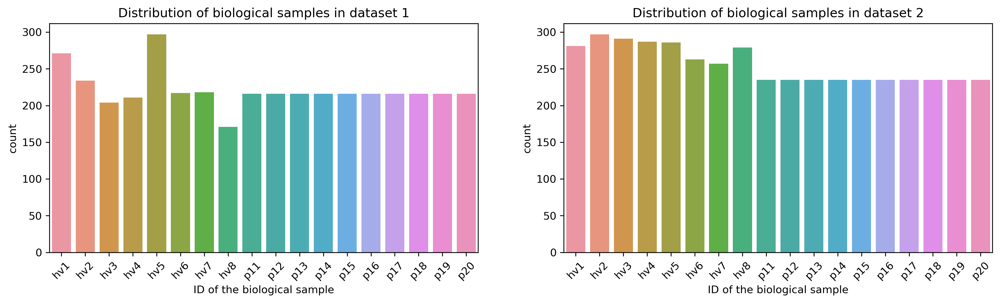

<IPython.core.display.Javascript object>

In [9]:
fig, ax = plt.subplots(figsize=[16, 4], ncols=2)
ax = ax.flatten()
ax[0] = sns.countplot(
    x="sample",
    data=sampled_rep1_data,
    ax=ax[0],
    order=np.unique(sampled_rep1_data.loc[:, "sample"]),
)
ax[1] = sns.countplot(
    x="sample",
    data=sampled_rep2_data,
    ax=ax[1],
    order=np.unique(sampled_rep2_data.loc[:, "sample"]),
)
for i in range(2):
    ax[i].set_xlabel("ID of the biological sample")
    ax[i].set_title("Distribution of biological samples in dataset {}".format(i + 1))
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(45)
plt.show()
plt.close()

----

#### Sample and feature selection

We now filter out constant features and nuclei with missing features. We will do that for both replicates individually. However, we will also combine the two replicates to provide a joint analysis.

In [10]:
rep1_data = preprocess_data(sampled_rep1_data, remove_constant_features=True)
rep2_data = preprocess_data(sampled_rep2_data, remove_constant_features=True)

Nuclei that did not pass the quality check: 0/3983. Remaining: 3983.
Removed 4 constant or features with missing values. Remaining: 260.
Removed additional 0 features. Remaining: 260.
Nuclei that did not pass the quality check: 0/4591. Remaining: 4591.
Removed 8 constant or features with missing values. Remaining: 258.
Removed additional 0 features. Remaining: 258.


<IPython.core.display.Javascript object>

In [11]:
sampled_rep1_data["rep"] = "1"
sampled_rep2_data["rep"] = "2"

data = preprocess_data(
    sampled_rep1_data.append(sampled_rep2_data), remove_constant_features=True
)

Nuclei that did not pass the quality check: 0/8574. Remaining: 8574.
Removed 87 constant or features with missing values. Remaining: 221.
Removed additional 0 features. Remaining: 221.


<IPython.core.display.Javascript object>

---

#### Data preparation

After sampling the data, we will now prepare the data for the consecutive analysis, i.e. extracting only chrometric features and corresponding metadata information.

In [12]:
chrometric_rep1_data = get_chrometric_data(
    rep1_data,
    proteins=["gh2ax", "lamin"],
    exclude_dna_int=True,
)
chrometric_rep2_data = get_chrometric_data(
    rep2_data, proteins=["cd4", "cd8"], exclude_dna_int=True
)

rep1_sample_labels = rep1_data.loc[:, "sample"]
rep2_sample_labels = rep2_data.loc[:, "sample"]

rep1_tp_labels = rep1_data.timepoint
rep2_tp_labels = rep2_data.timepoint

<IPython.core.display.Javascript object>

In [13]:
chrometric_data = get_chrometric_data(data, proteins=[], exclude_dna_int=True)
sample_labels = data.loc[:, "sample"]
tp_labels = data.timepoint
rep_labels = data.rep

<IPython.core.display.Javascript object>

Finally, we remove highly correlated features (Pearson $\rho > 0.8$) from the chrometric features.

In [14]:
chrometric_rep1_data = remove_correlated_features(chrometric_rep1_data, threshold=0.8)
chrometric_rep2_data = remove_correlated_features(chrometric_rep2_data, threshold=0.8)

Removed 146/193 features with a Pearson correlation above 0.8. Remaining: 47
Removed 143/193 features with a Pearson correlation above 0.8. Remaining: 50


<IPython.core.display.Javascript object>

In [15]:
chrometric_data = remove_correlated_features(chrometric_data, threshold=0.8)

Removed 143/193 features with a Pearson correlation above 0.8. Remaining: 50


<IPython.core.display.Javascript object>

---

## 3. Panels

Now we generate the individual panels for figure 2 of the paper.


### 3a. Visualization of the global nuclear phenotypes of control vs cancer population

First, we provide a visual representation of the different nuclear phenotypes in health and cancer. To this end, we will randomly sample 36 nuclei from each condition and plot a corresponding montage of the max-z projected DNA images. To visualize size differences each nuclei is padded to a size of 96x96 pixels.

In [16]:
image_file_path = "preprocessed/full_pipeline/segmentation/nuclei_images"
sampled_ctrl_rep1_images = get_random_images(
    rep1_data.loc[rep1_data.timepoint == "ctrl"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
)
sampled_ctrl_rep2_images = get_random_images(
    rep2_data.loc[rep2_data.timepoint == "ctrl"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
)

sampled_cond_rep1_images = get_random_images(
    rep1_data.loc[rep1_data.timepoint == "cancer"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
)
sampled_cond_rep2_images = get_random_images(
    rep2_data.loc[rep2_data.timepoint == "cancer"],
    image_file_path,
    data_dir_col="data_dir",
    n_images=36,
    seed=1234,
    file_ending=".tif",
)

<IPython.core.display.Javascript object>

### Dataset 1

#### Control population

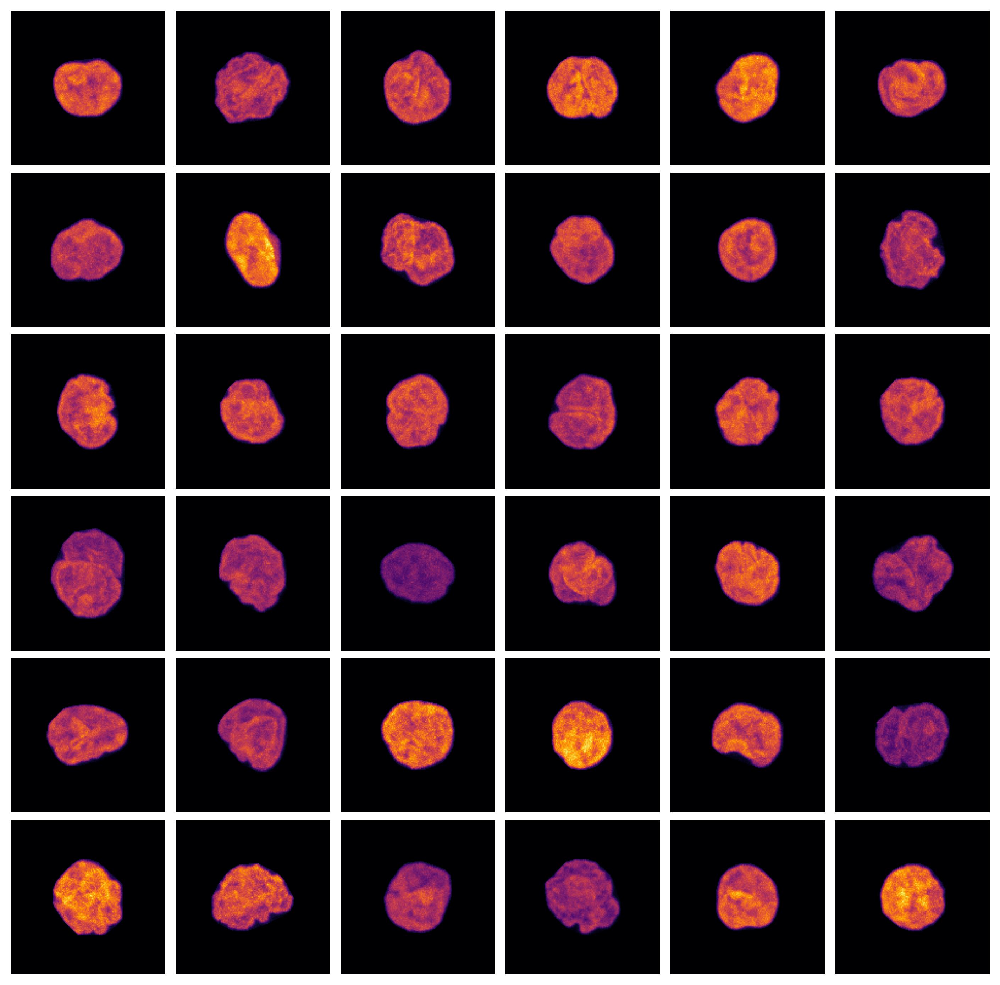

<IPython.core.display.Javascript object>

In [17]:
fig_rep1_ctrl, ax_rep1_ctrl = plot_montage(
    sampled_ctrl_rep1_images, pad_size=150, cmap="inferno", channel_first=False
)

#### Cancer population

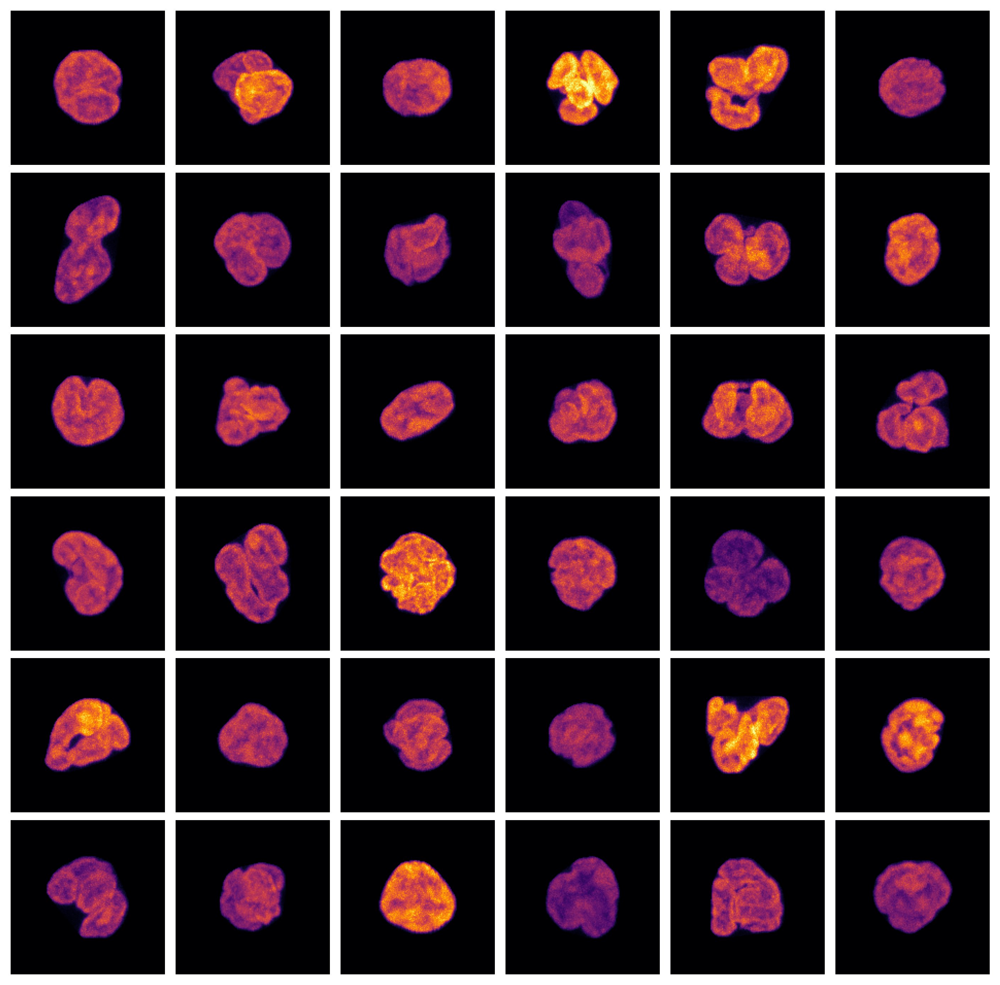

<IPython.core.display.Javascript object>

In [18]:
fig_rep1_cond, ax_rep1_cond = plot_montage(
    sampled_cond_rep1_images, pad_size=150, cmap="inferno", channel_first=False
)

---

###  Dataset 2

#### Control population

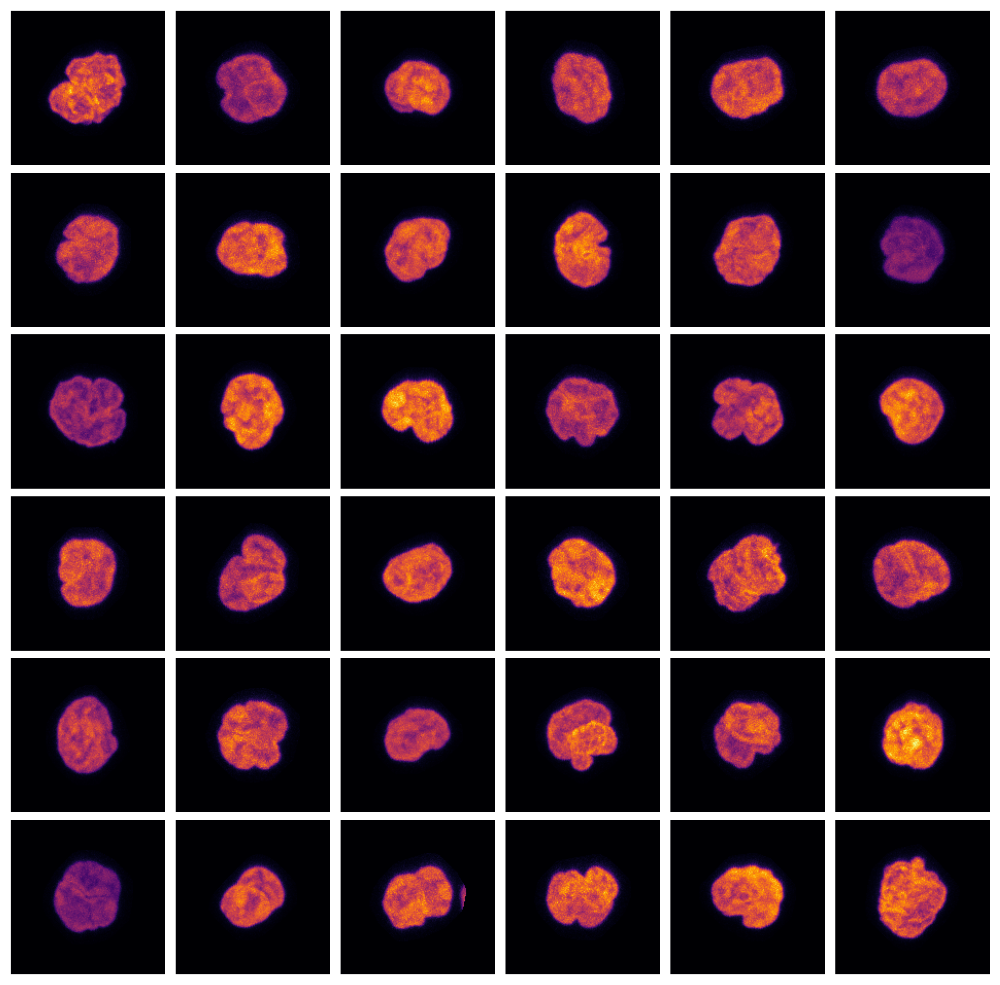

<IPython.core.display.Javascript object>

In [19]:
fig_rep2_ctrl, ax_rep2_ctrl = plot_montage(
    sampled_ctrl_rep2_images, pad_size=150, cmap="inferno", channel_first=False
)

---

#### Cancer population

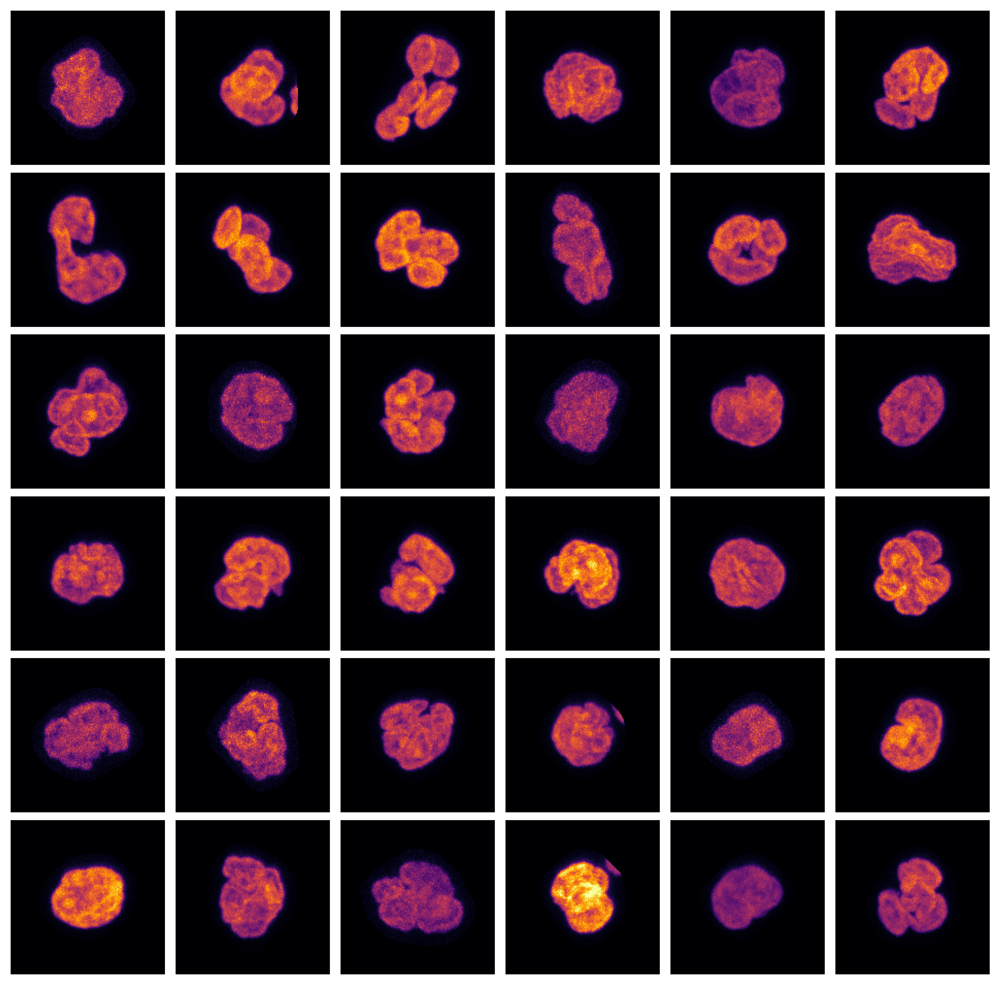

<IPython.core.display.Javascript object>

In [20]:
fig_rep2_cond, ax_rep2_cond = plot_montage(
    sampled_cond_rep2_images, pad_size=150, cmap="inferno", channel_first=False
)

---

### 3b. Parametric analysis captures large-scale differences between control and cancer population

The montages above indicate the large-scale differences between the control and cancer population, which are also reflected in the extracted chromatic features as shown by the separation of the classes in a tSNE plot and by the high classification performance of random forest classifier as seen below.

In [21]:
chrometric_rep1_embs = get_tsne_embs(chrometric_rep1_data)
chrometric_rep1_embs["condition"] = rep1_tp_labels
chrometric_rep1_embs["sample"] = rep1_sample_labels

chrometric_rep2_embs = get_tsne_embs(chrometric_rep2_data)
chrometric_rep2_embs["condition"] = rep2_tp_labels
chrometric_rep2_embs["sample"] = rep2_sample_labels

/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(
/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [22]:
chrometric_embs = get_tsne_embs(chrometric_data)
chrometric_embs["condition"] = tp_labels
chrometric_embs["sample"] = sample_labels
chrometric_embs["replicate"] = rep_labels

/home/paysan_d/miniconda3/envs/icp/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:991: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

#### Dataset 1

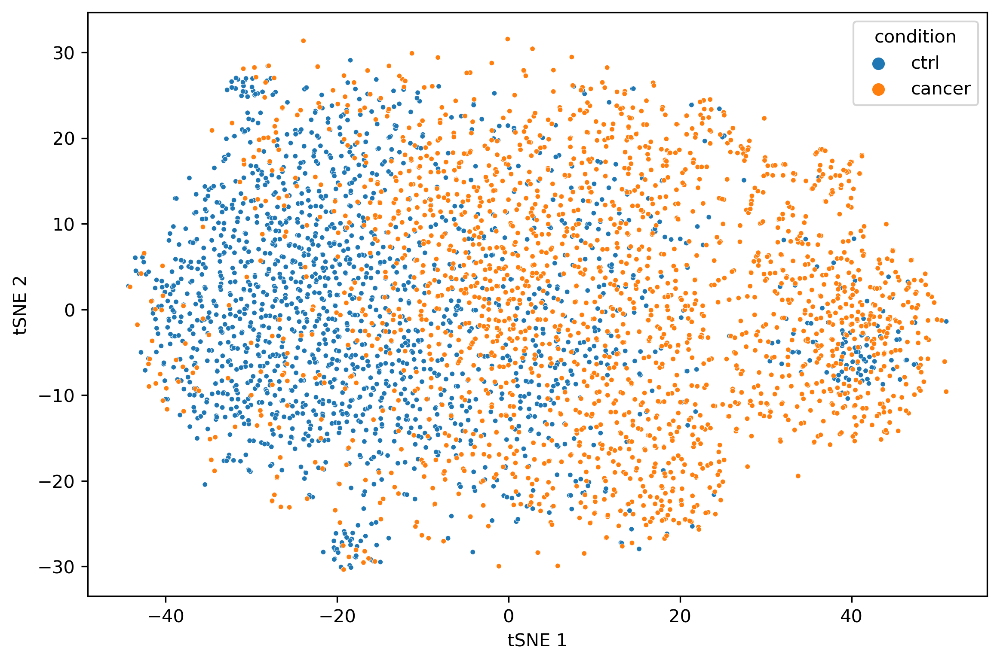

<IPython.core.display.Javascript object>

In [23]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep1_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="condition",
    hue_order=["ctrl", "cancer"],
    ax=ax,
    s=8,
    marker="o",
)
plt.show()

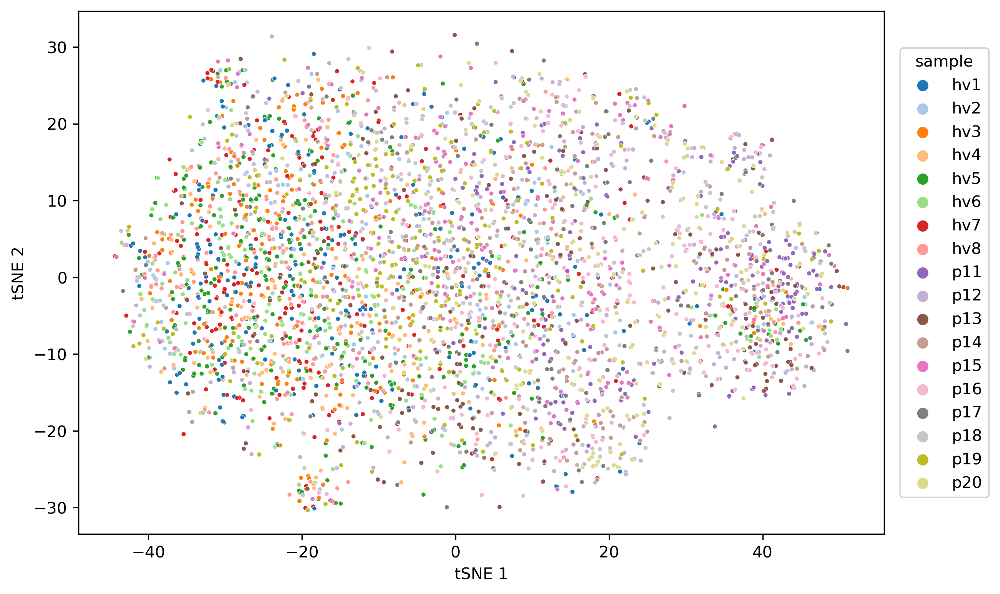

<IPython.core.display.Javascript object>

In [24]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep1_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_rep1_embs.loc[:, "sample"]),
    ax=ax,
    s=8,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

To quantify the separability of the two conditions we perform a 10-fold stratified cross-validation analysis using a RandomForest classifier. The classifier provides a simple non-linear classification model which also yields an importance measure for the individual chrometric features indicating which ones are most different between the two populations.

In [25]:
rfc = RandomForestClassifier(
    n_estimators=500, n_jobs=10, random_state=seed, class_weight="balanced"
)

<IPython.core.display.Javascript object>

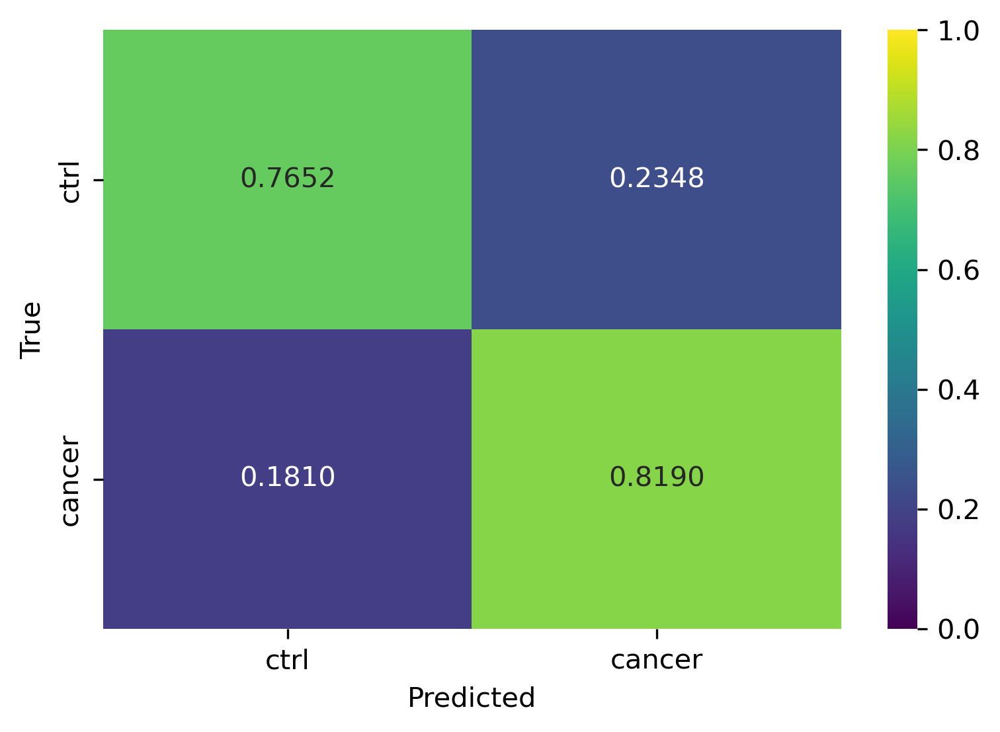

<IPython.core.display.Javascript object>

In [29]:
fig, ax, conf_mtx = plot_cv_conf_mtx(
    estimator=rfc,
    features=chrometric_rep1_data,
    labels=rep1_tp_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    order=["ctrl", "cancer"]
)


The classifier is able to accurately distinguish nuclei from the control and cancer population.

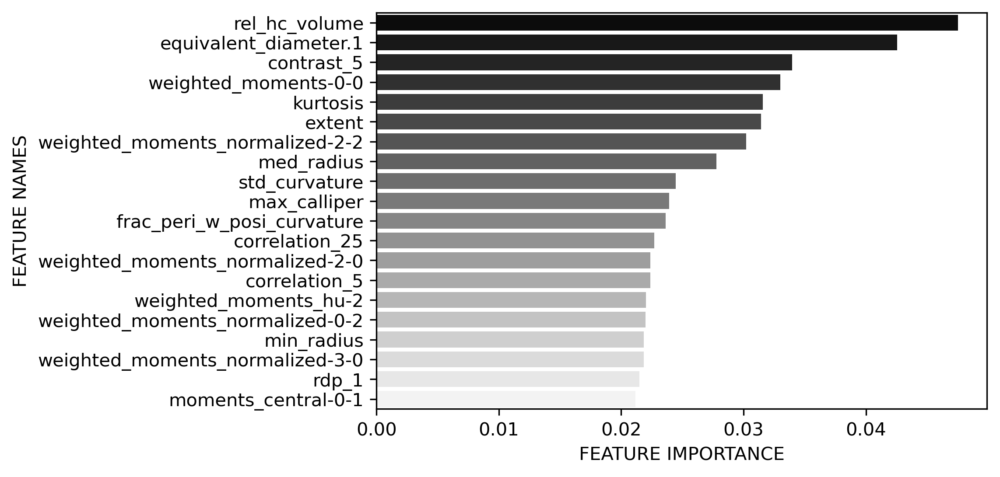

<IPython.core.display.Javascript object>

In [30]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    chrometric_rep1_data,
    rep1_sample_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

The analysis suggests that the heterochromatin content as well as the size of the nucleus and its shape are altered in the cancer population.

---

#### Dataset 2

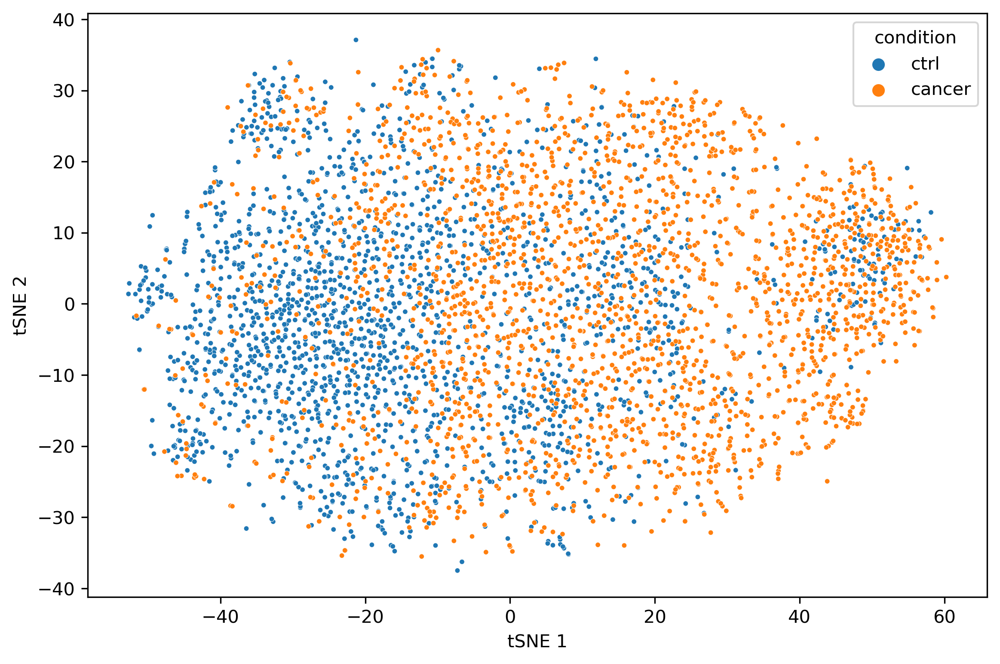

<IPython.core.display.Javascript object>

In [31]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep2_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="condition",
    hue_order=["ctrl", "cancer"],
    ax=ax,
    s=8,
    marker="o",
)

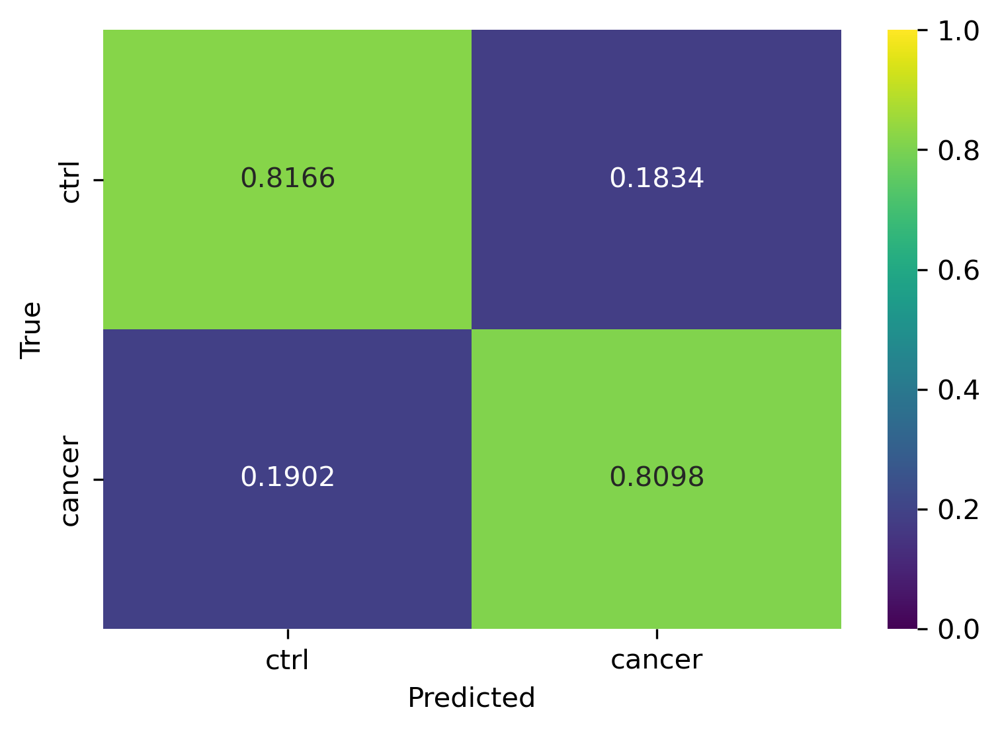

<IPython.core.display.Javascript object>

In [32]:
fig, ax, conf_mtx = plot_cv_conf_mtx(
    estimator=rfc,
    features=chrometric_rep2_data,
    labels=rep2_tp_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    order=["ctrl", "cancer"]
)


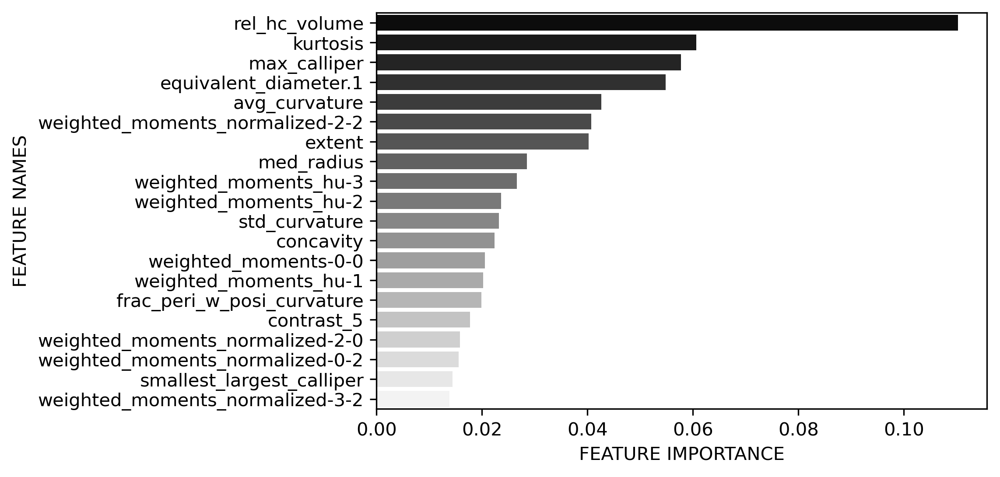

<IPython.core.display.Javascript object>

In [33]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    chrometric_rep2_data,
    rep2_tp_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

The results of the analysis of the second dataset align with the ones of the first.

In [ ]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_rep2_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_rep2_embs.loc[:, "sample"]),
    ax=ax,
    s=8,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

---

#### Combined data set

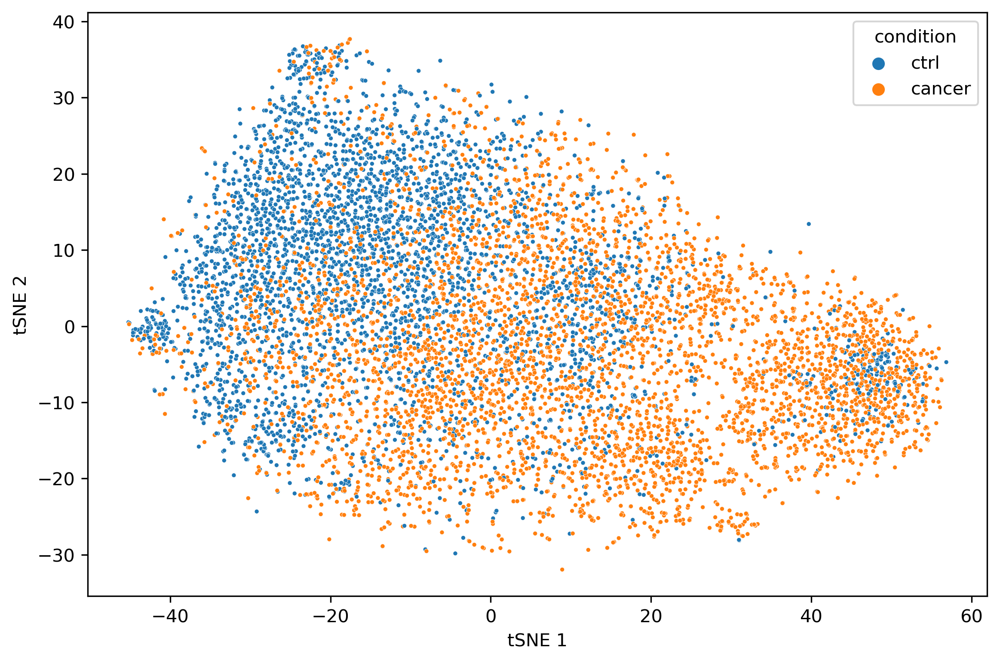

<IPython.core.display.Javascript object>

In [34]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="condition",
    hue_order=["ctrl", "cancer"],
    ax=ax,
    s=6,
    marker="o",
)

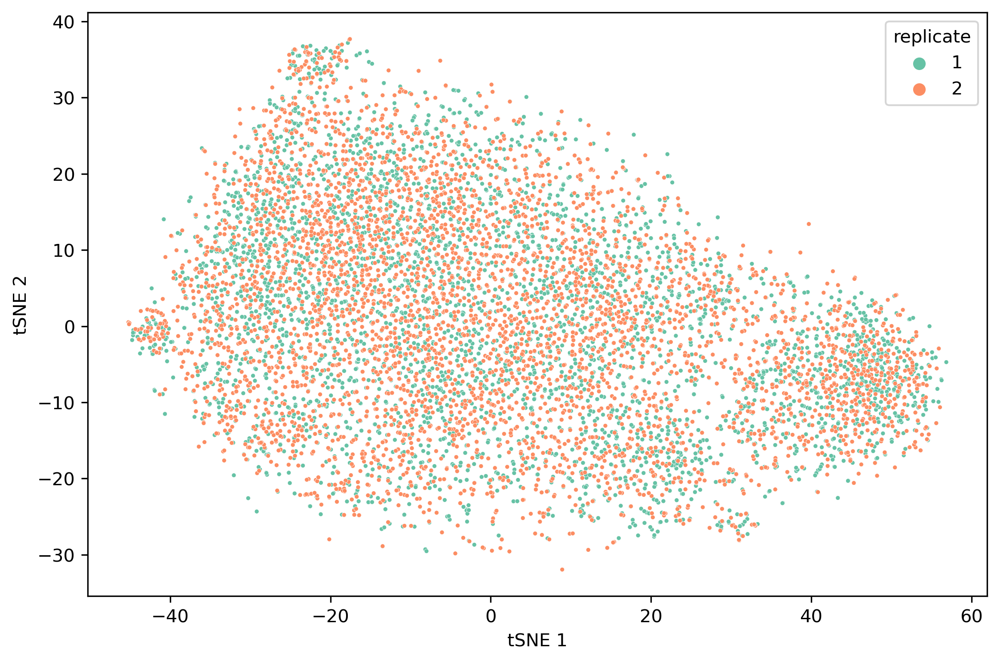

<IPython.core.display.Javascript object>

In [35]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="replicate",
    hue_order=["1", "2"],
    ax=ax,
    s=6,
    marker="o",
    palette="Set2",
)

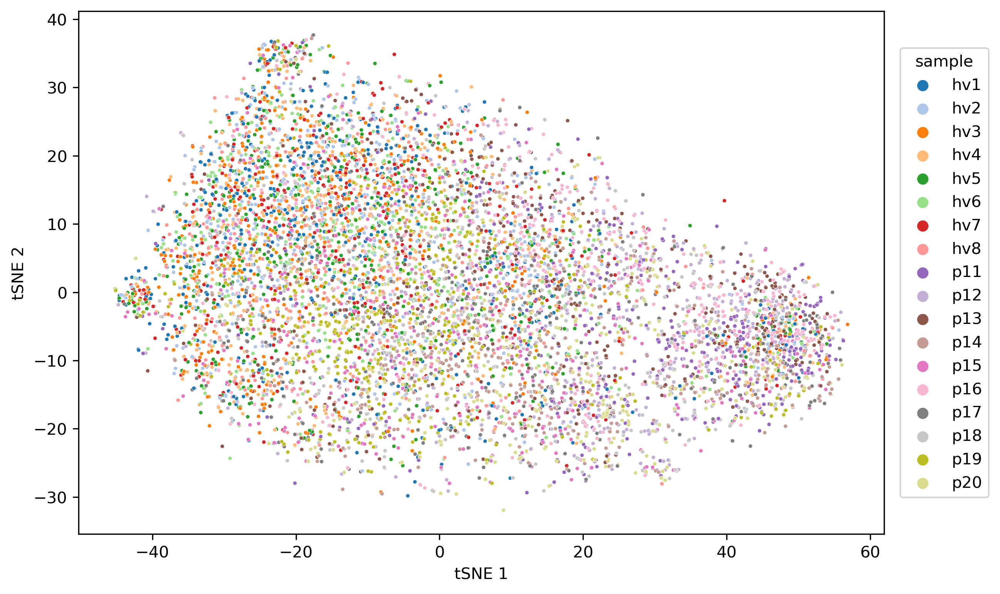

<IPython.core.display.Javascript object>

In [36]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.scatterplot(
    data=chrometric_embs,
    x="tSNE 1",
    y="tSNE 2",
    hue="sample",
    hue_order=np.unique(chrometric_embs.loc[:, "sample"]),
    ax=ax,
    s=6,
    marker="o",
    palette="tab20",
)
plt.legend(
    bbox_to_anchor=(1.02, 0.5), loc="center left", borderaxespad=0, title="sample"
)
plt.show()

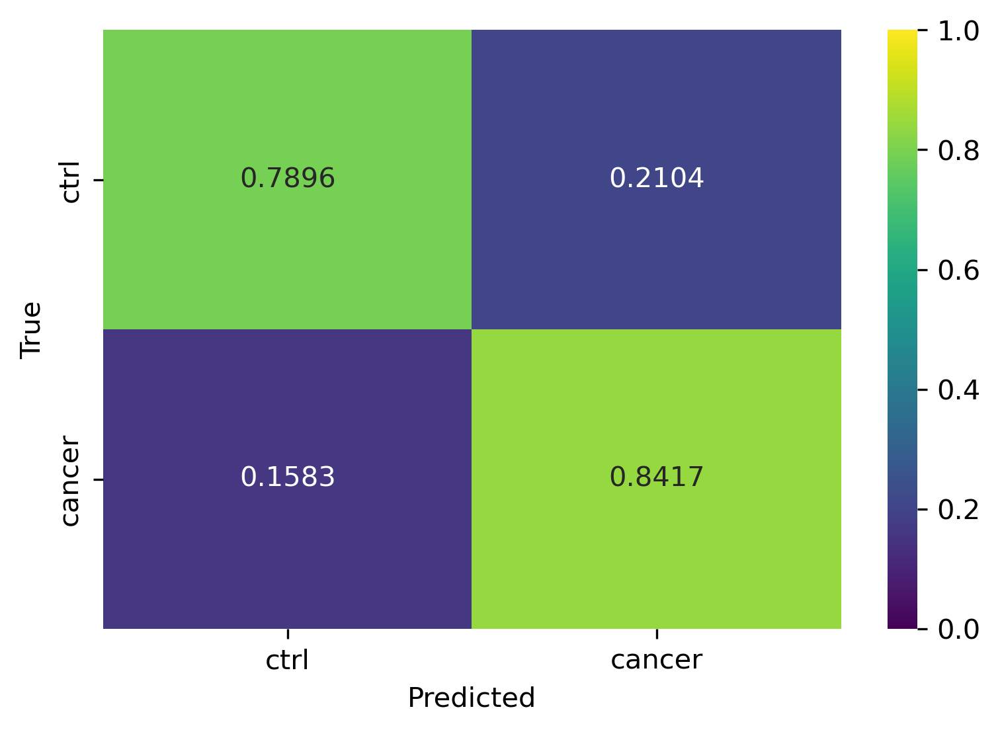

<IPython.core.display.Javascript object>

In [37]:
fig, ax, conf_mtx = plot_cv_conf_mtx(
    estimator=rfc,
    features=chrometric_data,
    labels=tp_labels,
    scale_features=True,
    n_folds=10,
    cmap="viridis",
    figsize=[6, 4],
    order=["ctrl", "cancer"]
)


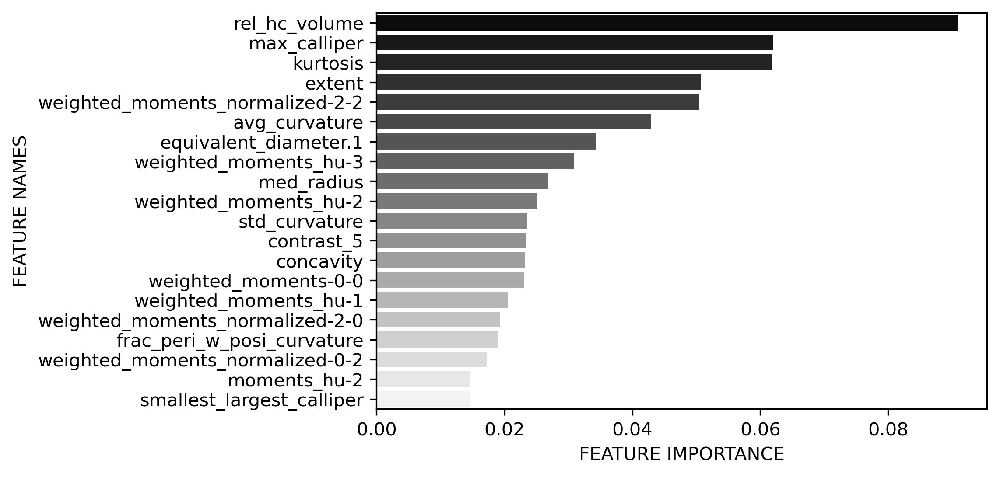

<IPython.core.display.Javascript object>

In [38]:
fig, ax = plot_feature_importance_for_estimator(
    rfc,
    chrometric_data,
    tp_labels,
    scale_features=True,
    cmap="gray",
    figsize=[6, 4],
)

The results of the analysis are in great agreement with those of the replicate-specific datasets.

---

### 3c. Nuclear chromatin biomarkers identifying cancer populations

While the previously shown feature importance plots already suggest a number of candidate chrometric biomarkers that capture the differences of the nuclear phenotypes in health and cancer, we run marker screen by testing for differential distributions of the individual chrometric features between the control and cancer population. To this end, we apply a t-test to test for difference in the means and adjust for multiple testing using the Benjamini-Hochberg procedure.

#### Data set 1

In [39]:
marker_screen_rep1_results = find_markers(chrometric_rep1_data, rep1_tp_labels)
marker_screen_rep1_results.loc[marker_screen_rep1_results.label == "cancer"].head(10)

Run marker screen:   0%|          | 0/2 [00:00<?, ?it/s]

,label,marker,fc,abs_delta_fc,pval,pval_adjust
1,cancer,max_calliper,1.111638,0.111638,8.158171e-238,3.834340e-236
13,cancer,kurtosis,0.303951,0.696049,1.777759e-222,4.177734e-221
44,cancer,extent,0.888817,0.111183,1.682989e-203,2.636683e-202
45,cancer,rel_hc_volume,1.068903,0.068903,1.391993e-142,1.635592e-141
4,cancer,med_radius,1.056794,0.056794,5.716143e-141,5.373174e-140
28,cancer,weighted_moments_normalized-2-2,1.516363,0.516363,1.812593e-134,1.419864e-133
6,cancer,std_curvature,1.174882,0.174882,6.440585e-113,4.324393e-112
15,cancer,contrast_5,0.827803,0.172197,4.952659e-109,2.909687e-108
26,cancer,weighted_moments_normalized-2-0,1.210813,0.210813,8.261078e-108,4.314119e-107
5,cancer,area_bbarea,0.961989,0.038011,5.664839e-95,2.662474e-94


<IPython.core.display.Javascript object>

We find that the most significantly different features are a number of size features such as the maximum caliper, extent and median radius, as well as features related to the curvature of the nucleus and the intranuclear chromatin compaction in the (rel_hc_volume and kurtosis)

As a joint proxy to study the alterations in size, we focus at the nuclear volume, the variation in the shape by the concavity as well as the aspect ratio of the nucleus and the change in chromatin compaction by the relative heterochromatin to euchromatin ratio.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:6.695e-52 t=-1.538e+01


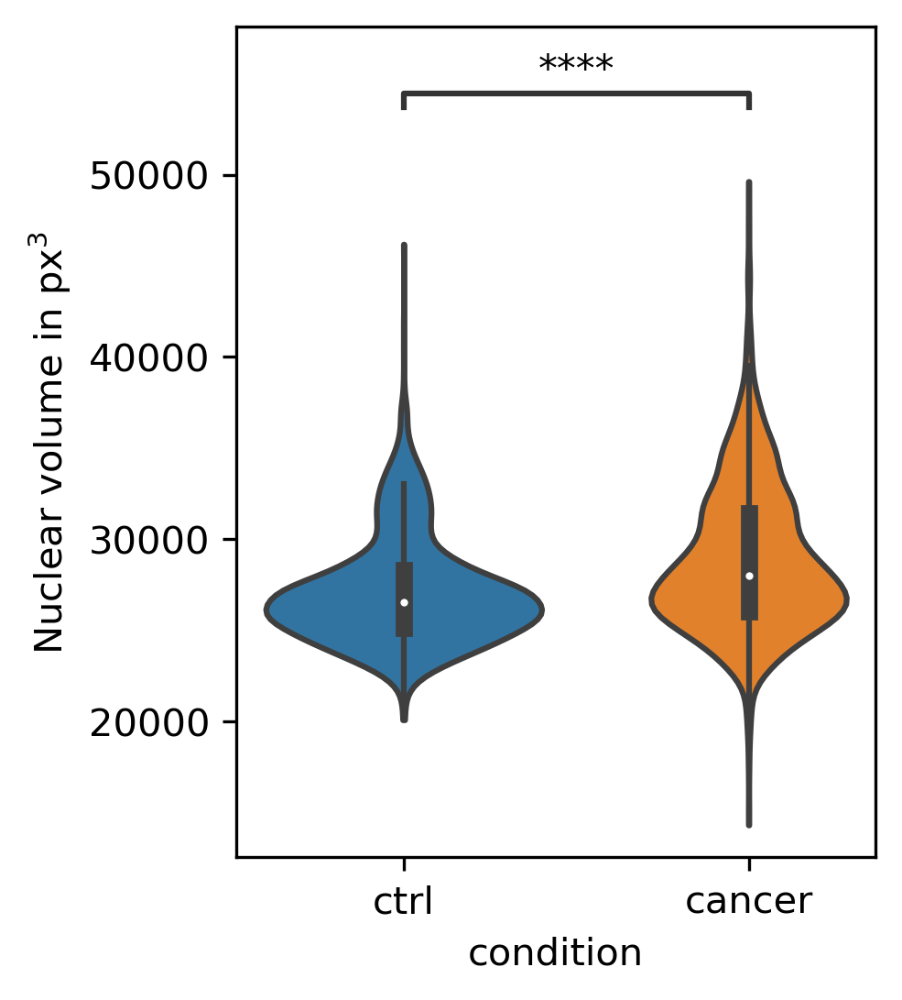

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:4.466e-145 t=-2.675e+01


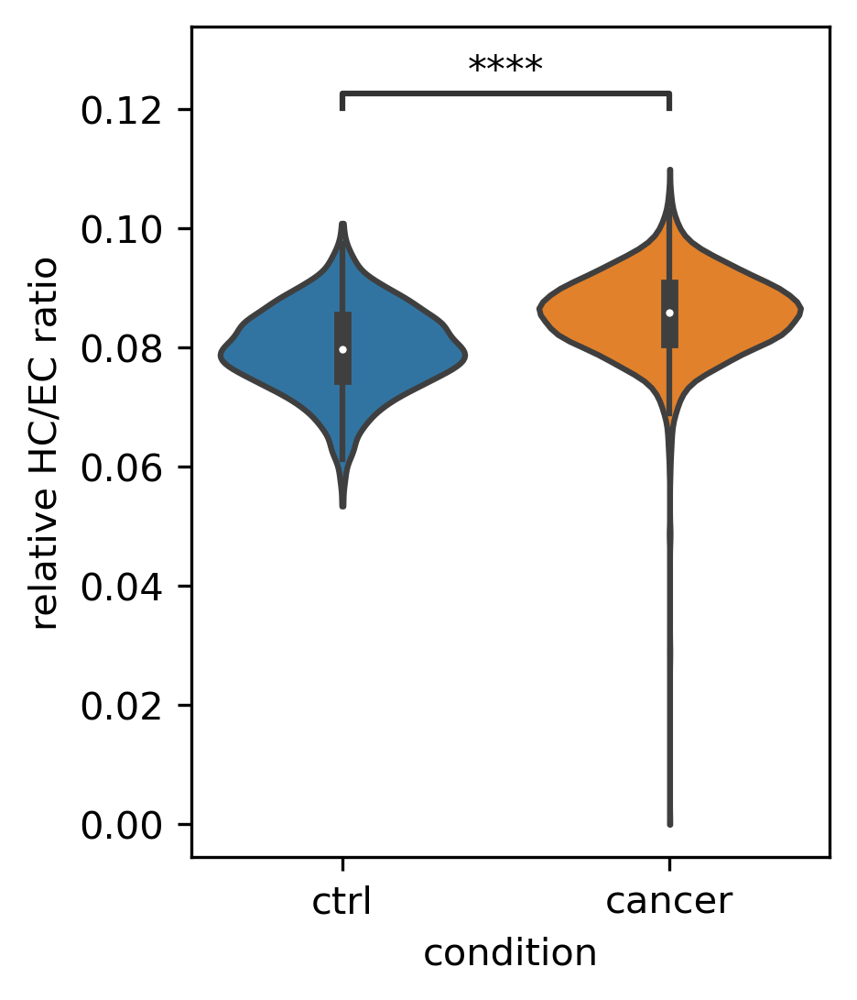

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:1.767e-229 t=-3.459e+01


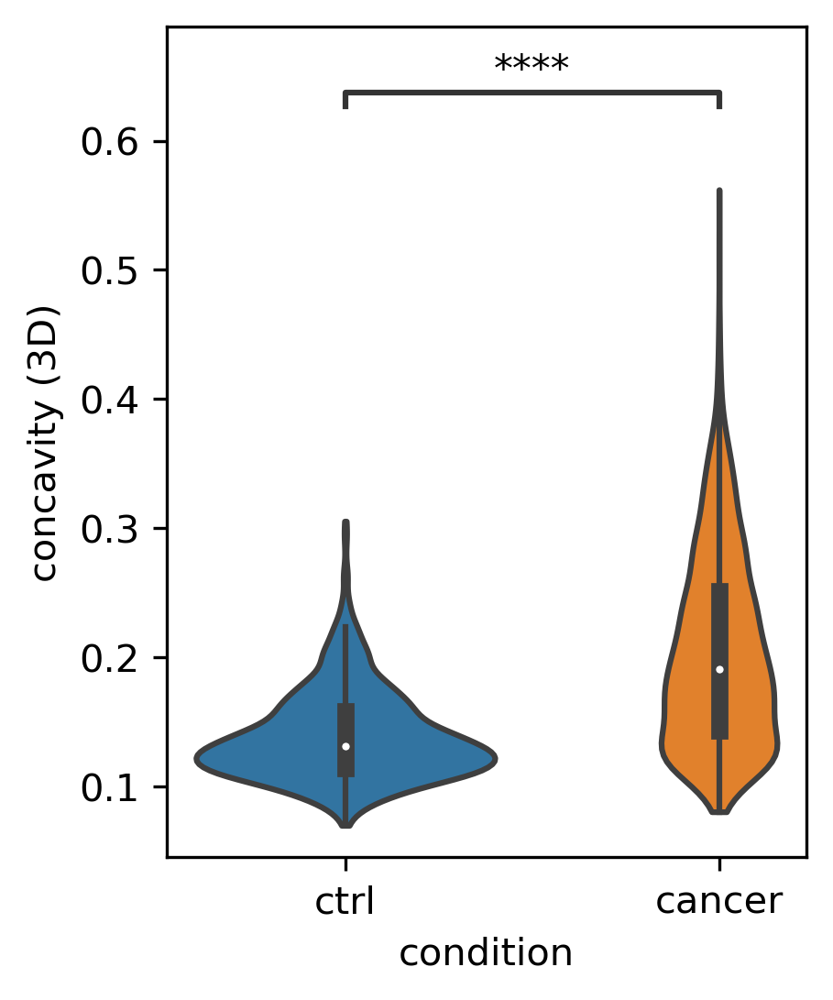

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:7.004e-67 t=1.761e+01


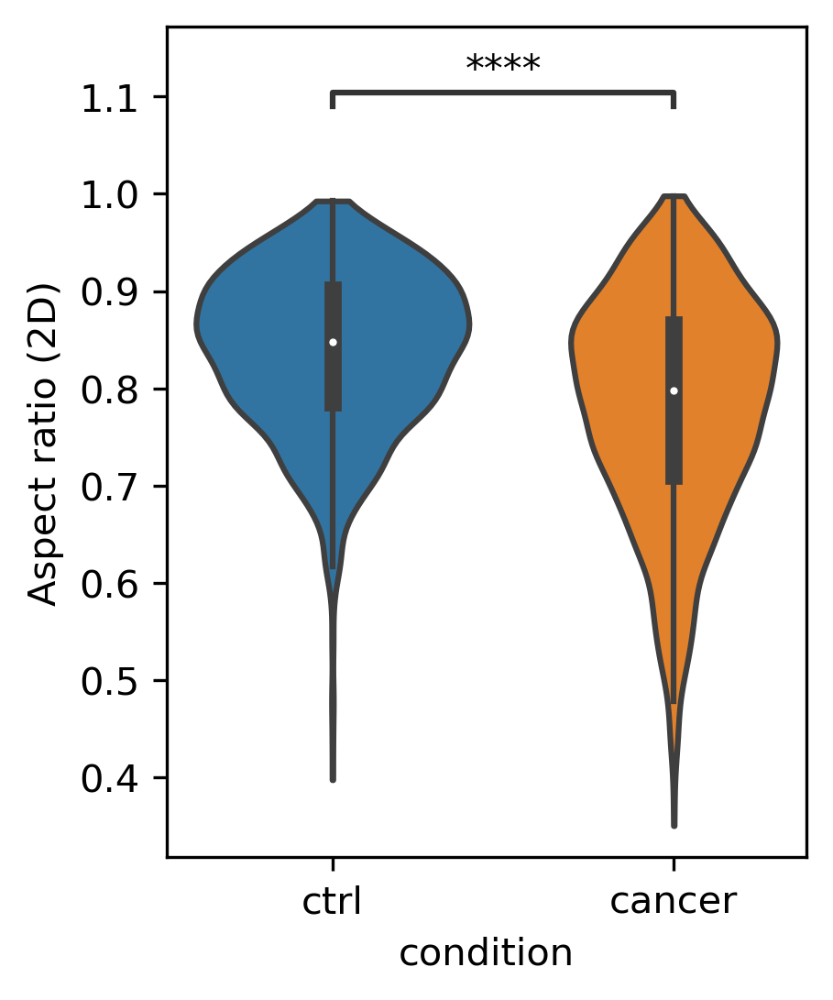

<IPython.core.display.Javascript object>

In [40]:
markers = ["nuclear_volume", "hc_ec_ratio_3d", "concavity_3d", "a_r"]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
    "concavity (3D)",
    "Aspect ratio (2D)",
]
plot_ctrl_cancer_markers_dist(rep1_data, markers, marker_labels, cut=0)

---

#### Data set 2

In [41]:
marker_screen_rep2_results = find_markers(chrometric_rep2_data, rep2_tp_labels)
marker_screen_rep2_results.loc[marker_screen_rep2_results.label == "cancer"].head(10)

Run marker screen:   0%|          | 0/2 [00:00<?, ?it/s]

,label,marker,fc,abs_delta_fc,pval,pval_adjust
16,cancer,kurtosis,0.366310,0.633690,1.621663e-219,8.108317e-218
1,cancer,max_calliper,1.096210,0.096210,2.113323e-203,5.283308e-202
48,cancer,rel_hc_volume,1.065241,0.065241,3.864477e-195,6.440795e-194
47,cancer,extent,0.907653,0.092347,1.280787e-163,1.600984e-162
7,cancer,avg_curvature,0.932557,0.067443,3.436256e-145,3.436256e-144
4,cancer,med_radius,1.049133,0.049133,3.504125e-126,2.920104e-125
5,cancer,concavity,1.455426,0.455426,9.728581e-114,6.948986e-113
8,cancer,std_curvature,1.159922,0.159922,7.030382e-113,4.393989e-112
30,cancer,weighted_moments_normalized-2-2,1.415143,0.415143,1.109095e-106,6.161641e-106
6,cancer,area_bbarea,0.965276,0.034724,3.921401e-85,1.960701e-84


<IPython.core.display.Javascript object>

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:1.014e-19 t=-9.129e+00


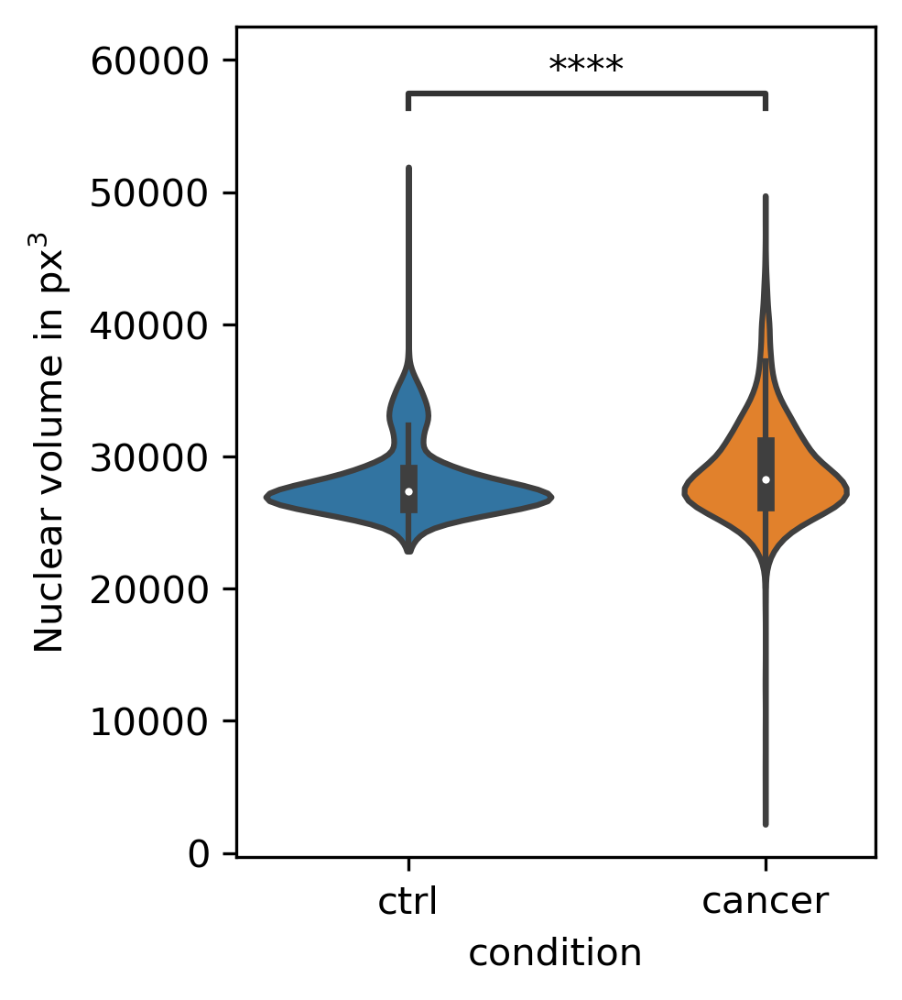

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:4.439e-196 t=-3.139e+01


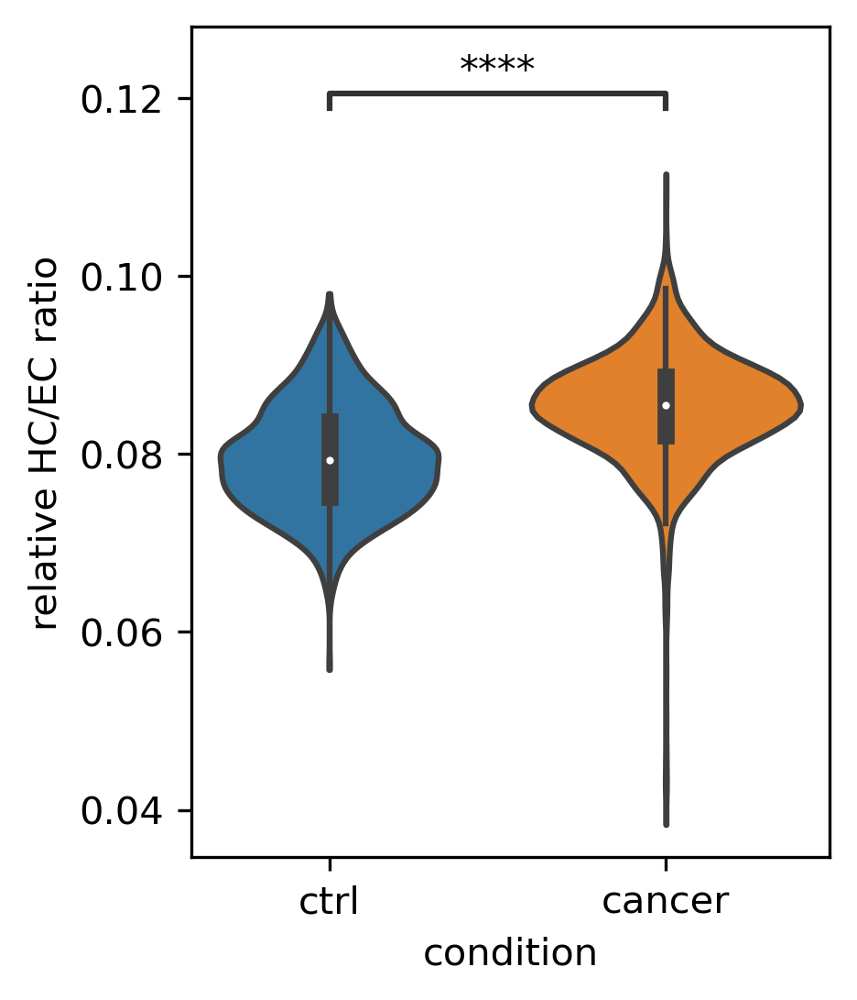

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:1.641e-227 t=-3.411e+01


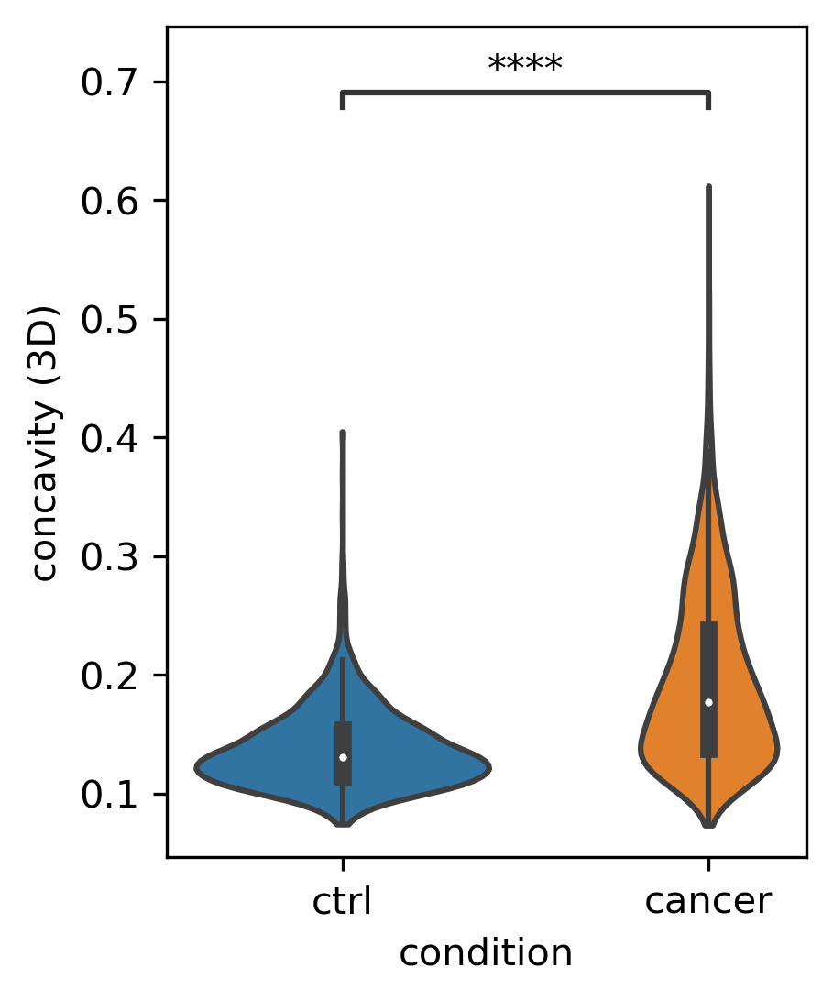

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:3.240e-56 t=1.602e+01


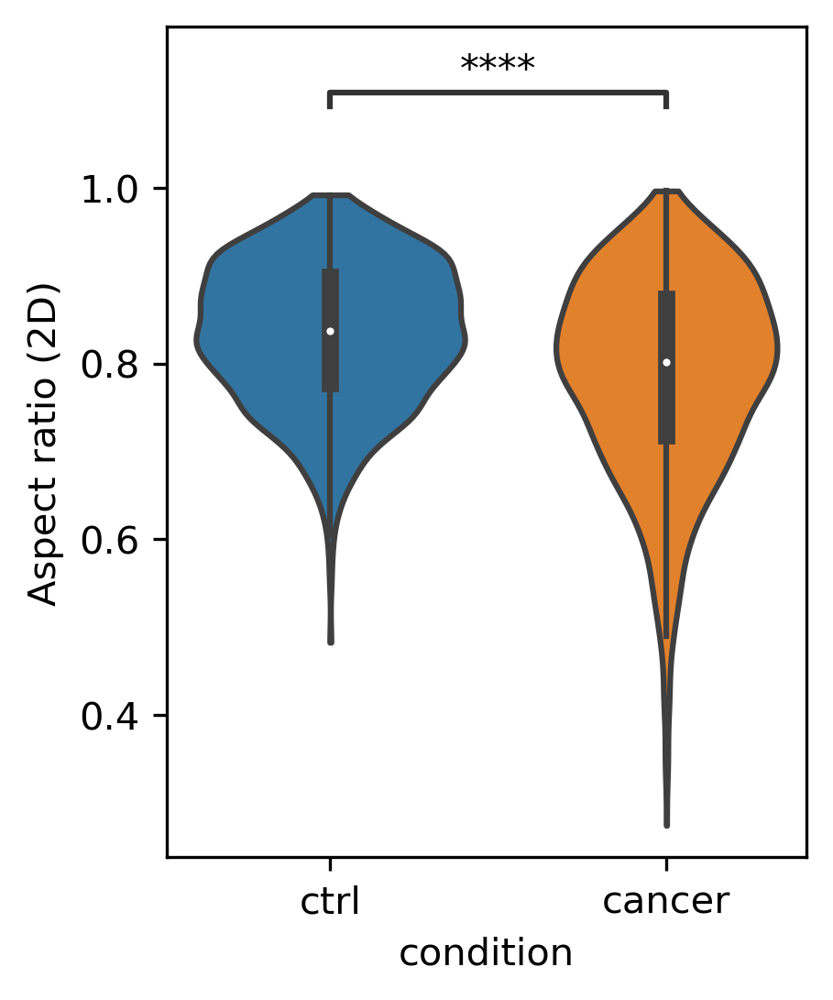

<IPython.core.display.Javascript object>

In [42]:
markers = ["nuclear_volume", "hc_ec_ratio_3d", "concavity_3d", "a_r"]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
    "concavity (3D)",
    "Aspect ratio (2D)",
]
plot_ctrl_cancer_markers_dist(rep2_data, markers, marker_labels, cut=0)

---

#### Combined data set

In [43]:
marker_screen_results = find_markers(chrometric_data, tp_labels)
marker_screen_results.loc[marker_screen_results.label == "cancer"].head(10)

Run marker screen:   0%|          | 0/2 [00:00<?, ?it/s]

,label,marker,fc,abs_delta_fc,pval,pval_adjust
48,cancer,rel_hc_volume,1.067013,0.067013,0.000000e+00,0.000000e+00
47,cancer,extent,0.898616,0.101384,0.000000e+00,0.000000e+00
15,cancer,kurtosis,0.336148,0.663852,0.000000e+00,0.000000e+00
7,cancer,avg_curvature,0.927481,0.072519,0.000000e+00,0.000000e+00
1,cancer,max_calliper,1.103409,0.103409,0.000000e+00,0.000000e+00
4,cancer,med_radius,1.052658,0.052658,9.035932e-265,7.529943e-264
5,cancer,concavity,1.479251,0.479251,1.921482e-244,1.372487e-243
29,cancer,weighted_moments_normalized-2-2,1.460935,0.460935,1.825460e-236,1.140913e-235
8,cancer,std_curvature,1.166936,0.166936,3.440364e-224,1.911314e-223
6,cancer,area_bbarea,0.963754,0.036246,2.858641e-177,1.429320e-176


<IPython.core.display.Javascript object>

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:4.356e-64 t=-1.704e+01


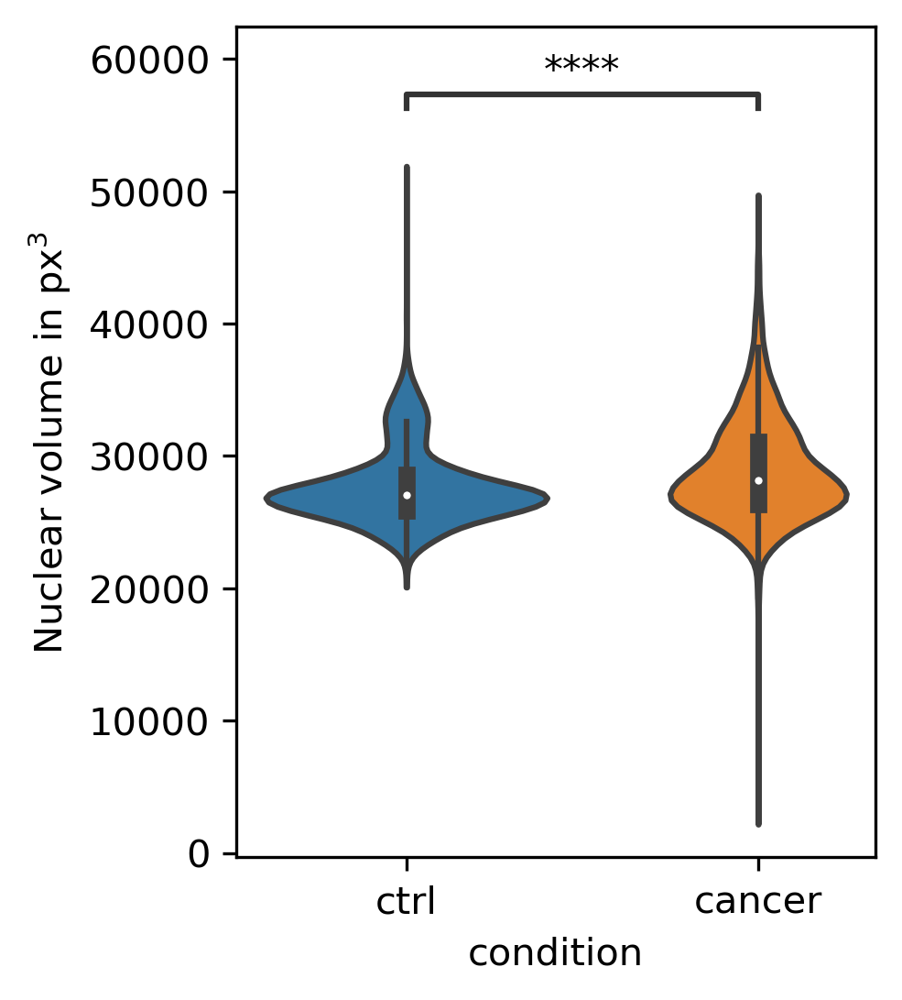

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:0.000e+00 t=-4.103e+01


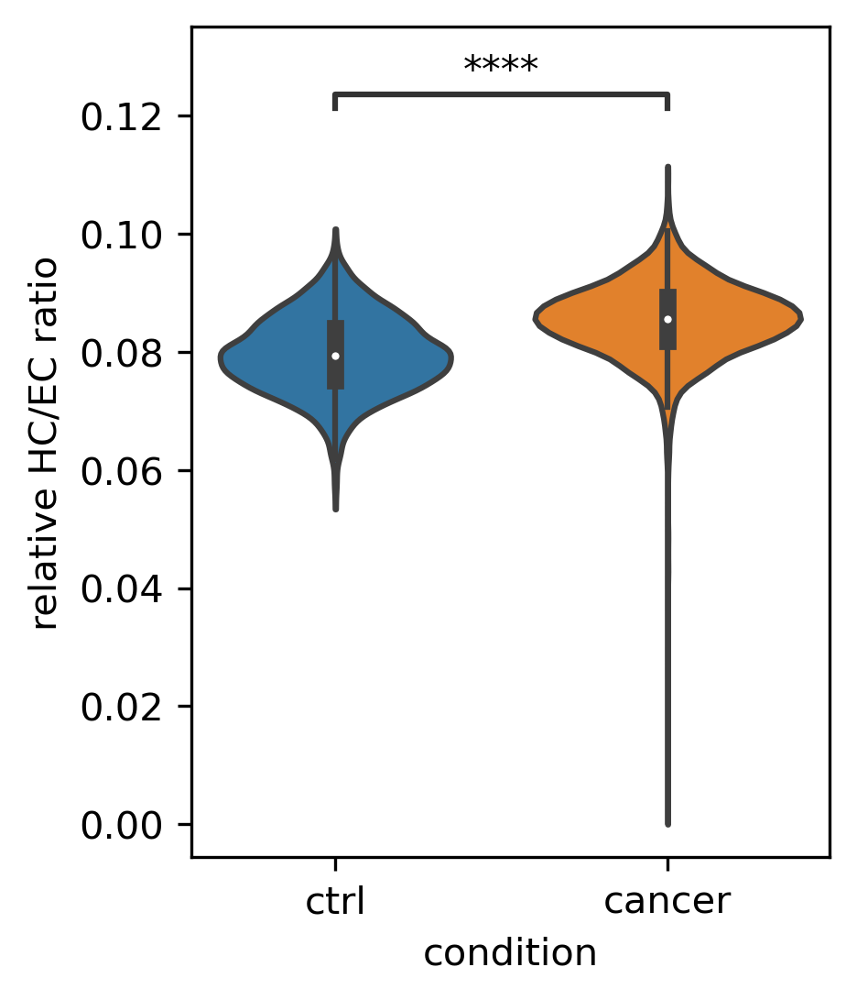

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:0.000e+00 t=-4.864e+01


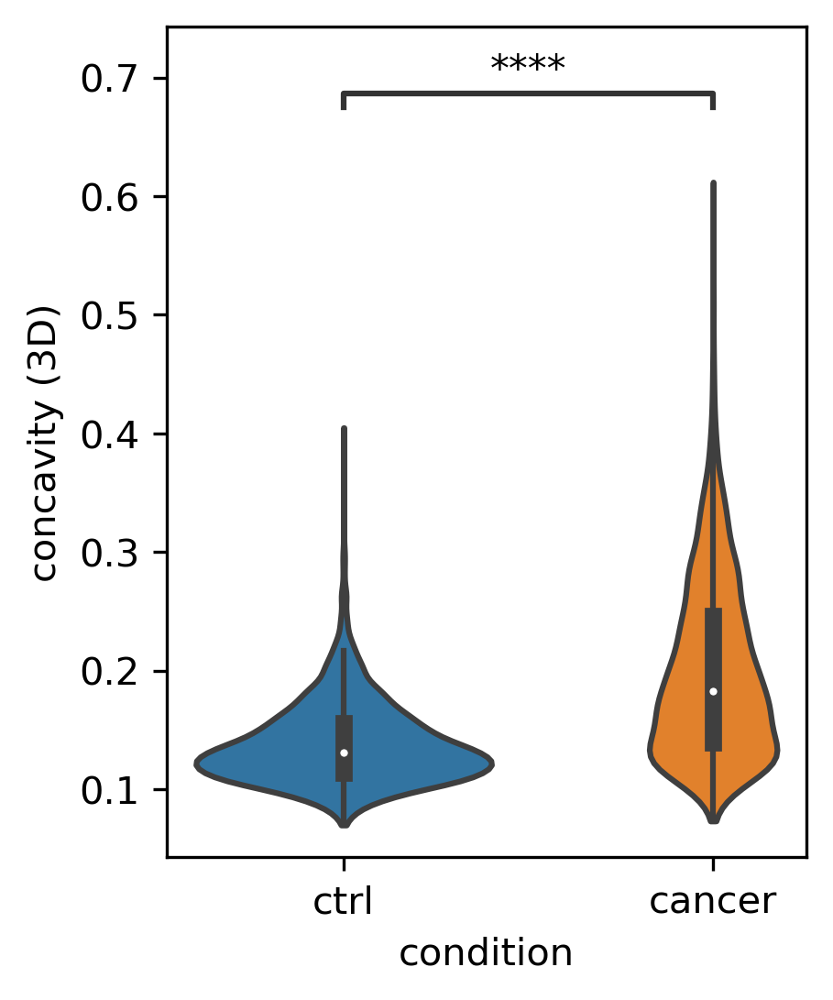

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:8.653e-121 t=2.375e+01


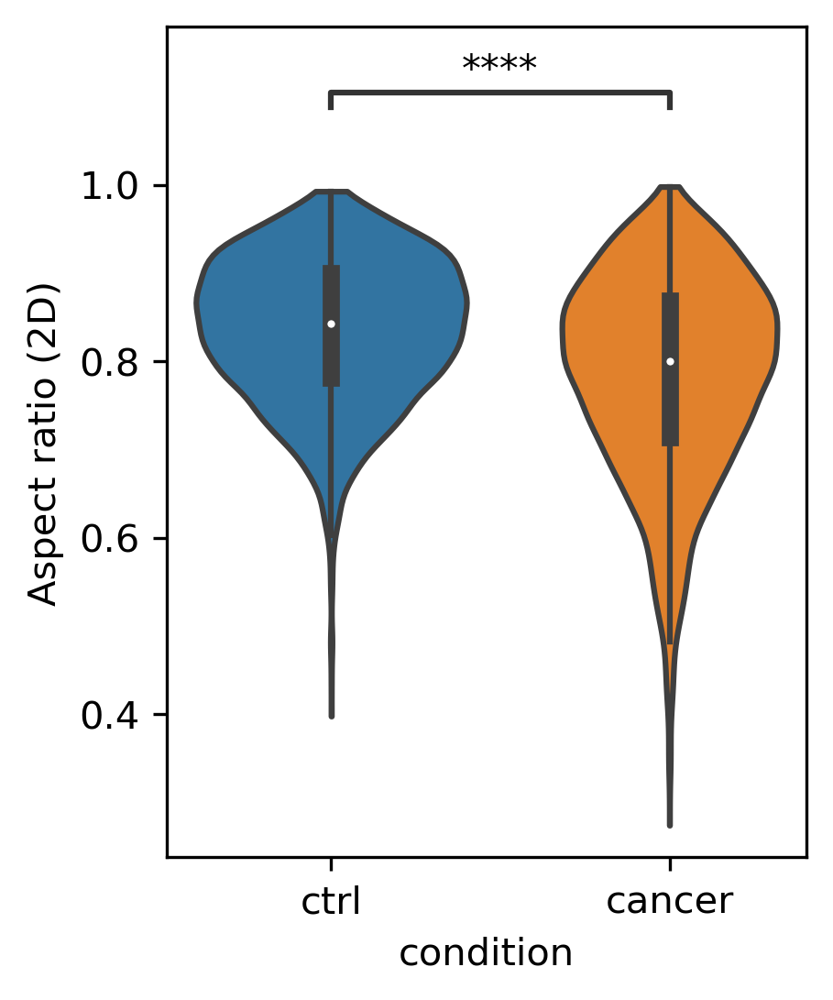

<IPython.core.display.Javascript object>

In [44]:
markers = ["nuclear_volume", "hc_ec_ratio_3d", "concavity_3d", "a_r"]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
    "concavity (3D)",
    "Aspect ratio (2D)",
]
plot_ctrl_cancer_markers_dist(data, markers, marker_labels, cut=0)

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_ctrl vs. 2_cancer: t-test independent samples, P_val:1.014e-19 t=-9.129e+00
1_ctrl vs. 1_cancer: t-test independent samples, P_val:6.695e-52 t=-1.538e+01
1_cancer vs. 2_ctrl: t-test independent samples, P_val:1.352e-14 t=7.727e+00
1_ctrl vs. 2_ctrl: t-test independent samples, P_val:1.316e-26 t=-1.075e+01
1_cancer vs. 2_cancer: t-test independent samples, P_val:3.720e-01 t=-8.929e-01
1_ctrl vs. 2_cancer: t-test independent samples, P_val:7.899e-63 t=-1.702e+01


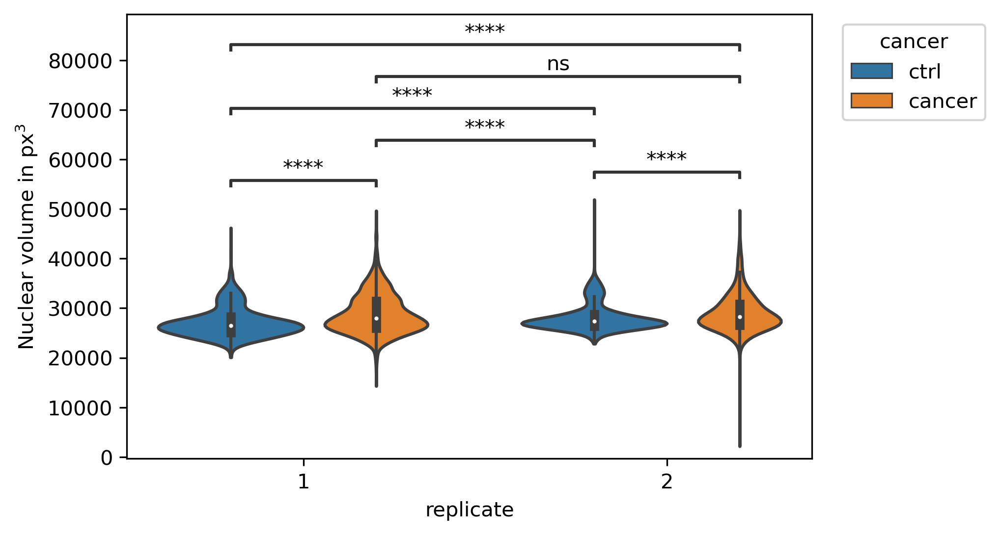

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_ctrl vs. 2_cancer: t-test independent samples, P_val:4.439e-196 t=-3.139e+01
1_ctrl vs. 1_cancer: t-test independent samples, P_val:4.466e-145 t=-2.675e+01
1_cancer vs. 2_ctrl: t-test independent samples, P_val:1.533e-188 t=3.078e+01
1_ctrl vs. 2_ctrl: t-test independent samples, P_val:7.706e-01 t=2.916e-01
1_cancer vs. 2_cancer: t-test independent samples, P_val:5.107e-02 t=1.951e+00
1_ctrl vs. 2_cancer: t-test independent samples, P_val:4.418e-150 t=-2.720e+01


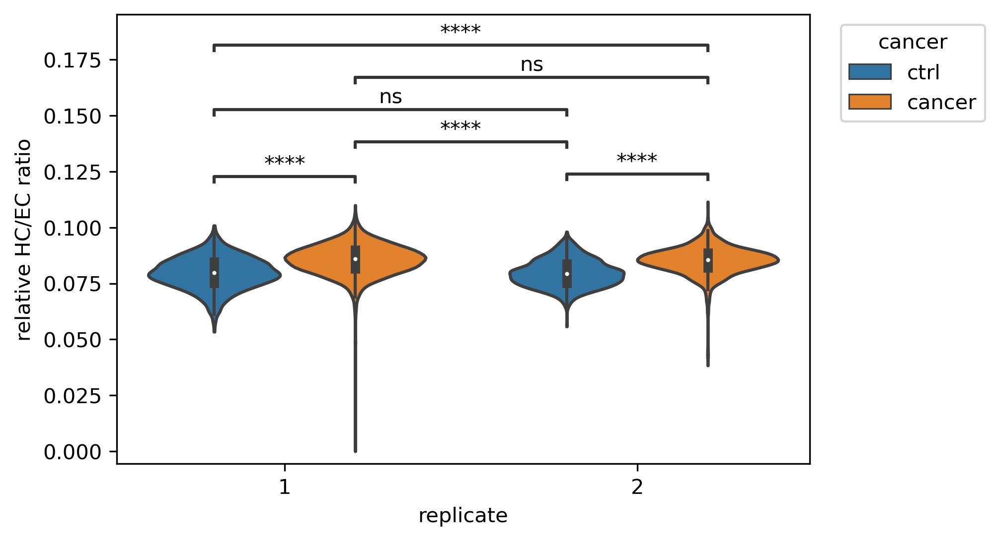

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_ctrl vs. 2_cancer: t-test independent samples, P_val:1.641e-227 t=-3.411e+01
1_ctrl vs. 1_cancer: t-test independent samples, P_val:1.767e-229 t=-3.459e+01
1_cancer vs. 2_ctrl: t-test independent samples, P_val:2.689e-283 t=3.878e+01
1_ctrl vs. 2_ctrl: t-test independent samples, P_val:1.324e-01 t=1.505e+00
1_cancer vs. 2_cancer: t-test independent samples, P_val:3.681e-05 t=4.131e+00
1_ctrl vs. 2_cancer: t-test independent samples, P_val:2.705e-182 t=-3.029e+01


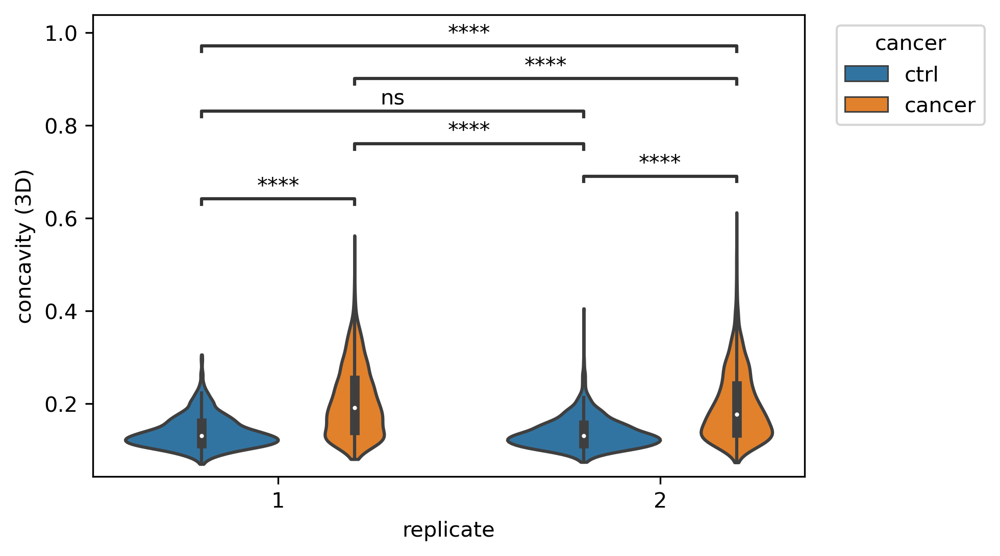

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

2_ctrl vs. 2_cancer: t-test independent samples, P_val:3.240e-56 t=1.602e+01
1_ctrl vs. 1_cancer: t-test independent samples, P_val:7.004e-67 t=1.761e+01
1_cancer vs. 2_ctrl: t-test independent samples, P_val:2.378e-66 t=-1.750e+01
1_ctrl vs. 2_ctrl: t-test independent samples, P_val:9.301e-02 t=1.680e+00
1_cancer vs. 2_cancer: t-test independent samples, P_val:1.262e-01 t=-1.529e+00
1_ctrl vs. 2_cancer: t-test independent samples, P_val:1.871e-57 t=1.622e+01


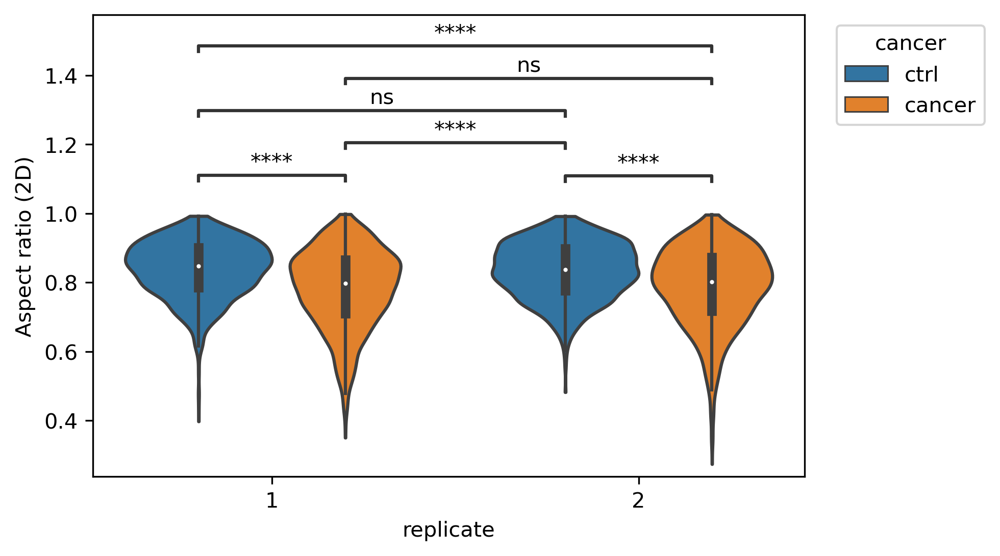

<IPython.core.display.Javascript object>

In [56]:
markers = ["nuclear_volume", "hc_ec_ratio_3d", "concavity_3d", "a_r"]
marker_labels = [
    r"Nuclear volume in px$^3$",
    "relative HC/EC ratio",
    "concavity (3D)",
    "Aspect ratio (2D)",
]
for i in range(len(markers)):
    fig, ax = plot_marker_distribution(
        data=data,
        figsize=[6, 4],
        marker=markers[i],
        label_col="rep",
        hue="timepoint",
        hue_order=["ctrl", "cancer"],
        box_pairs=[
            (("1", "ctrl"), ("2", "ctrl")),
            (("1", "ctrl"), ("1", "cancer")),
            (("1", "cancer"), ("2", "cancer")),
            (("1", "cancer"), ("2", "ctrl")),
            (("2", "cancer"), ("2", "ctrl")),
            (("2", "cancer"), ("1", "ctrl")),
        ],
        stat_annot="star",
        quantiles=None,
        cut=0,
        plot_type="violin",
    )
    ax.set_xlabel("replicate")
    ax.set_ylabel(marker_labels[i])
    plt.legend(title="cancer", loc="upper left", bbox_to_anchor=(1.03, 1))
    plt.show()
    plt.close()

---

### 3d. Proteomic differences of PBMCs in cancer

Finally, we also assess the proteomic differences between the control and cancer populations. To this end, we plot the relative Lamin and gH2AX expression measured by the sum of the intensities of the corresponding imaging channels normalized by the nuclear volume. Additionally, we plot the number of identified gH2AX foci which are computed as the local maxima peaks found in the corresponding channel images.

Note that those features are only available for the first data set that was stained for those proteins.

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:1.263e-55 t=1.596e+01


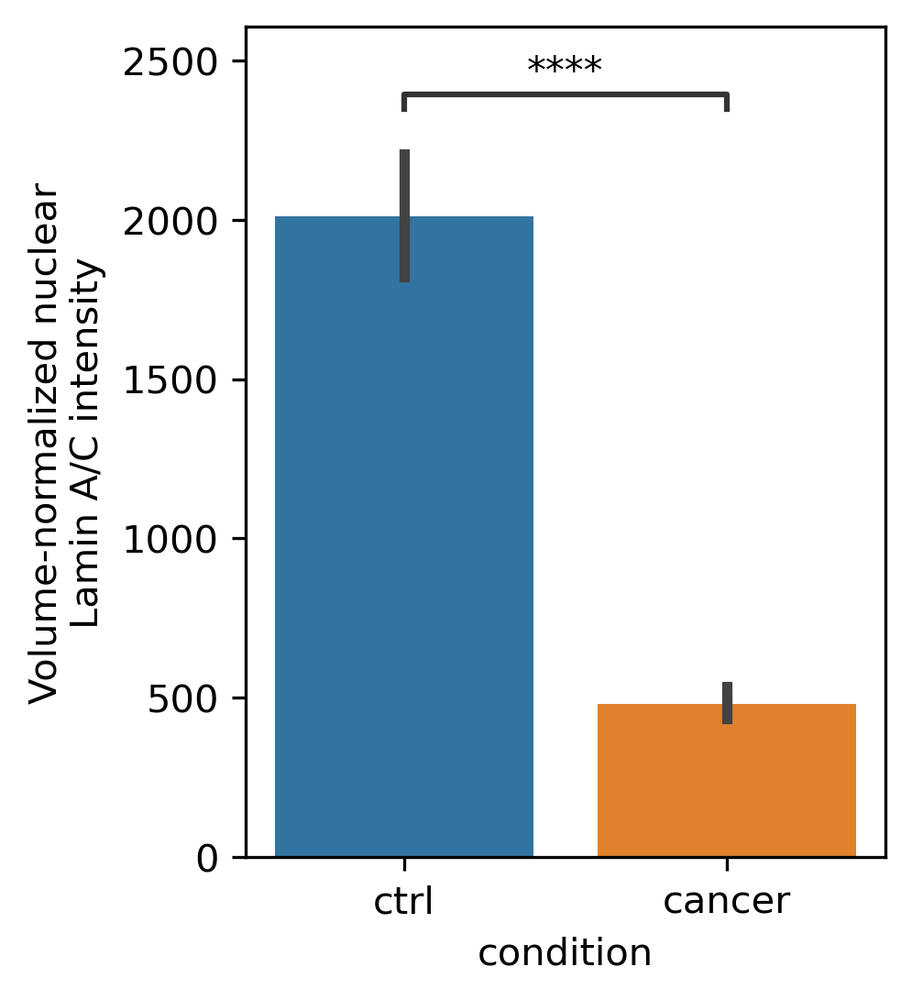

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:4.076e-267 t=3.777e+01


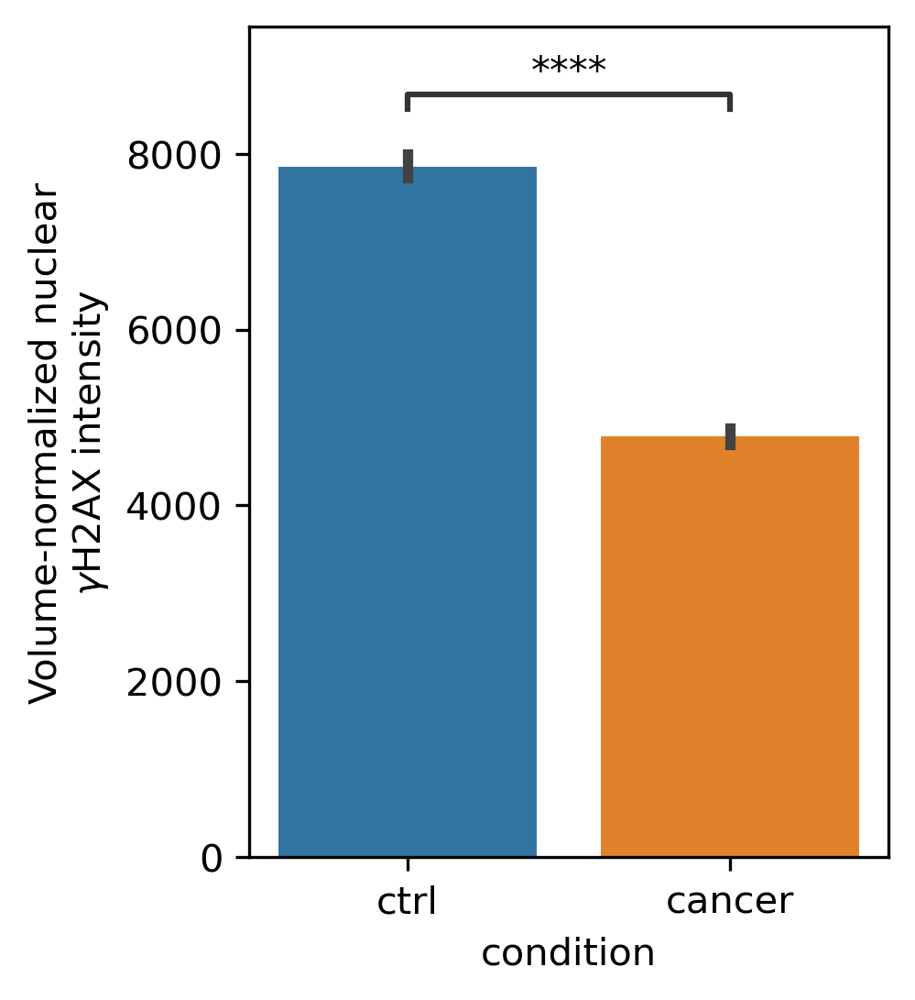

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ctrl vs. cancer: t-test independent samples, P_val:3.548e-03 t=-2.917e+00


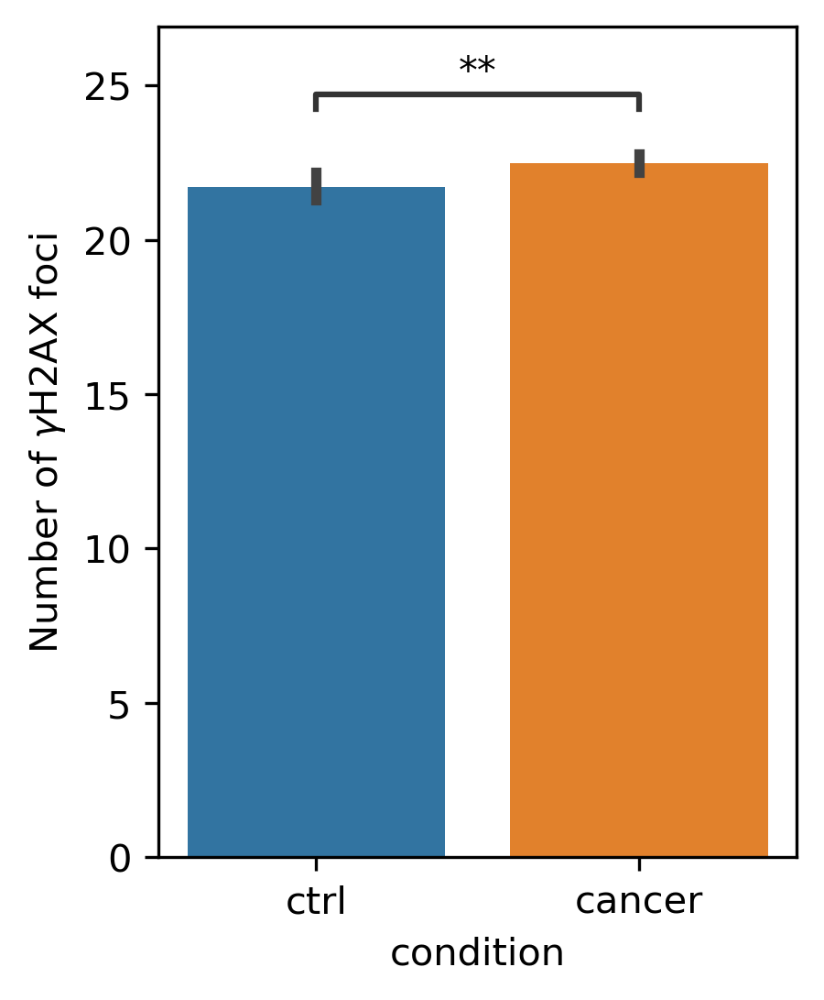

<IPython.core.display.Javascript object>

In [45]:
markers = ["rel_lamin_3d_int", "rel_gh2ax_3d_int", "gh2ax_foci_count"]
marker_labels = [
    "Volume-normalized nuclear\nLamin A/C intensity",
    "Volume-normalized nuclear\n" r"$\gamma$H2AX intensity",
    r"Number of $\gamma$H2AX foci",
]
plot_ctrl_cancer_markers_dist(
    rep1_data, markers, marker_labels, quantiles=None, cut=0, plot_type="bar"
)

In [46]:
np.min(rep1_data.loc[rep1_data.timepoint == "ctrl", "rel_lamin_3d_int"])

165.8403588453887

<IPython.core.display.Javascript object>

---

## 4. Supplemental

In [47]:
features = [
    "max_caliper",
    "rel_hc_volume",
    "kurtosis",
    "extent",
    "med_radius",
    "avg_curvature",
]
plot_feature_visualization(rep1_data, features=features, image)

SyntaxError: positional argument follows keyword argument (<ipython-input-47-e2890044fad4>, line 9)

<IPython.core.display.Javascript object>